In [1]:
import os, warnings
from pathlib import Path

import anndata as ad
import numpy as np
import dynamo as dyn
import spateo as st
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

2023-09-16 22:39:33.739272: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-09-16 22:39:33.760698: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-16 22:39:34.128112: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
from typing import Optional, Tuple, Union

import matplotlib as mpl
import numpy as np
from pyvista import PolyData, UniformGrid, UnstructuredGrid

try:
    from typing import Literal
except ImportError:
    from typing_extensions import Literal


def add_model_labels(
        model: Union[PolyData, UnstructuredGrid, UniformGrid],
        labels: np.ndarray,
        key_added: str = "groups",
        where: Literal["point_data", "cell_data"] = "cell_data",
        colormap: Union[str, list, dict, np.ndarray] = "rainbow",
        alphamap: Union[float, list, dict, np.ndarray] = 1.0,
        mask_color: Optional[str] = "gainsboro",
        mask_alpha: Optional[float] = 0.0,
        inplace: bool = False,
) -> Tuple[Optional[PolyData or UnstructuredGrid], Optional[Union[str]]]:
    model = model.copy() if not inplace else model
    labels = np.asarray(labels).flatten()

    cu_arr = np.sort(np.unique(labels), axis=0).astype(object)
    raw_labels_hex = labels.copy().astype(object)
    raw_labels_alpha = labels.copy().astype(object)
    raw_labels_hex[raw_labels_hex == "mask"] = mpl.colors.to_hex(mask_color)
    raw_labels_alpha[raw_labels_alpha == "mask"] = mask_alpha

    # Set raw hex.
    if isinstance(colormap, str):
        if colormap in list(mpl.colormaps()):
            lscmap = mpl.cm.get_cmap(colormap)
            raw_hex_list = [mpl.colors.to_hex(lscmap(i)) for i in np.linspace(0, 1, len(cu_arr))]
            for label, color in zip(cu_arr, raw_hex_list):
                raw_labels_hex[raw_labels_hex == label] = color
        else:
            raw_labels_hex[raw_labels_hex != "mask"] = mpl.colors.to_hex(colormap)
    elif isinstance(colormap, dict):
        for label, color in colormap.items():
            raw_labels_hex[raw_labels_hex == label] = mpl.colors.to_hex(color)
    elif isinstance(colormap, list) or isinstance(colormap, np.ndarray):
        raw_hex_list = np.array([mpl.colors.to_hex(color) for color in colormap]).astype(object)
        for label, color in zip(cu_arr, raw_hex_list):
            raw_labels_hex[raw_labels_hex == label] = color
    else:
        raise ValueError("`colormap` value is wrong." "\nAvailable `colormap` types are: `str`, `list` and `dict`.")

    # Set raw alpha.
    if isinstance(alphamap, float) or isinstance(alphamap, int):
        raw_labels_alpha[raw_labels_alpha != "mask"] = alphamap
    elif isinstance(alphamap, dict):
        for label, alpha in alphamap.items():
            raw_labels_alpha[raw_labels_alpha == label] = alpha
    elif isinstance(alphamap, list) or isinstance(alphamap, np.ndarray):
        raw_labels_alpha = np.asarray(alphamap).astype(object)
    else:
        raise ValueError(
            "`alphamap` value is wrong." "\nAvailable `alphamap` types are: `float`, `list` and `dict`."
        )

    # Set rgba.
    labels_rgba = [mpl.colors.to_rgba(c, alpha=a) for c, a in zip(raw_labels_hex, raw_labels_alpha)]
    labels_rgba = np.array(labels_rgba).astype(np.float32)

    # Added rgba of the labels.
    if where == "point_data":
        model.point_data[f"{key_added}_rgba"] = labels_rgba
    else:
        model.cell_data[f"{key_added}_rgba"] = labels_rgba

    plot_cmap = None

    # Added labels.
    if where == "point_data":
        model.point_data[key_added] = labels
    else:
        model.cell_data[key_added] = labels

    return model if not inplace else None, plot_cmap

## Load the data

In [3]:
sample_id = "E7_8h"
os.chdir(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_{sample_id}_germ_layer_new")
cpo = [(41, 1209, 57), (13, 8, -3), (0, 0, 1)]

out_image_path = f"image/germband_migration_region"
Path(out_image_path).mkdir(parents=True, exist_ok=True)

In [4]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband_v4.h5ad")

germ_pc = st.tdr.read_model(f"morpho_models/germband_morphometrics_pc_model.vtk")
germ_mesh = st.tdr.read_model(f"morpho_models/germband_morphometrics_mesh_model.vtk")
trajectory_model = st.tdr.read_model(f"morpho_models/germband_morphofield_trajectory_model.vtk")
germ_adata

AnnData object with n_obs × n_vars = 12585 × 8120
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho', 'glm_degs', 'log1p', 'pp'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

## High migration regions with segments

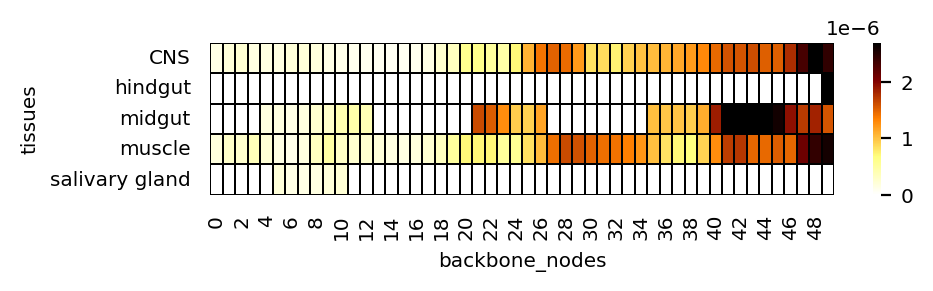

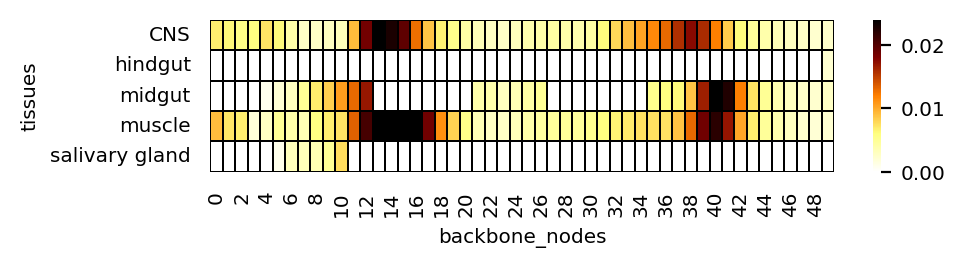

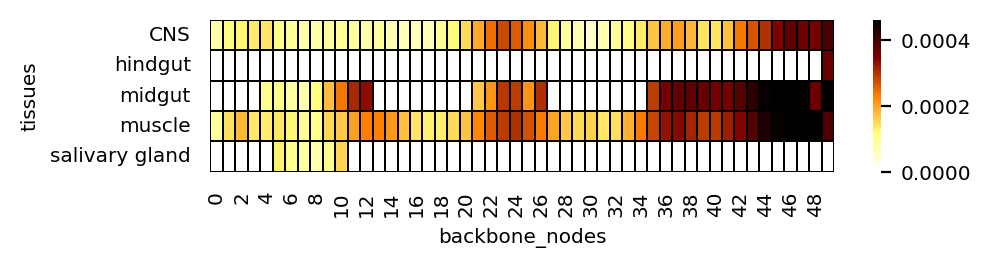

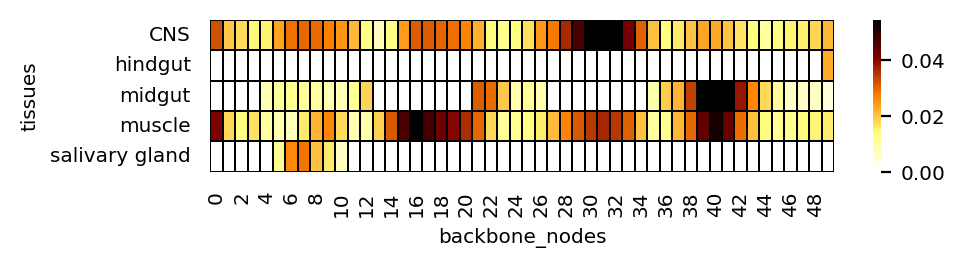

In [6]:
for mm in ['morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion']:
    morpho_data = germ_adata.obs[['anno_tissue_new', "backbone_nodes", mm]]
    morpho_data = pd.DataFrame(morpho_data.groupby(by=["backbone_nodes", "anno_tissue_new"]).mean())
    morpho_data.fillna(value=0, inplace=True)
    morpho_data["backbone_nodes"] = [i for i, j in morpho_data.index]
    morpho_data["tissues"] = [j for i, j in morpho_data.index]
    morpho_data.index = range(len(morpho_data.index))
    morpho_data = pd.pivot_table(morpho_data, index="backbone_nodes", columns="tissues", values=mm).T
    f, ax = plt.subplots(figsize=(5, 1))
    sns.heatmap(data=morpho_data, cmap="afmhot_r", ax=ax, linewidths=0.1, linecolor="black", robust=True)
    plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_{mm}_backbones_tissues_heatmap.pdf"), dpi=300, format="pdf", bbox_inches="tight")
    plt.show()

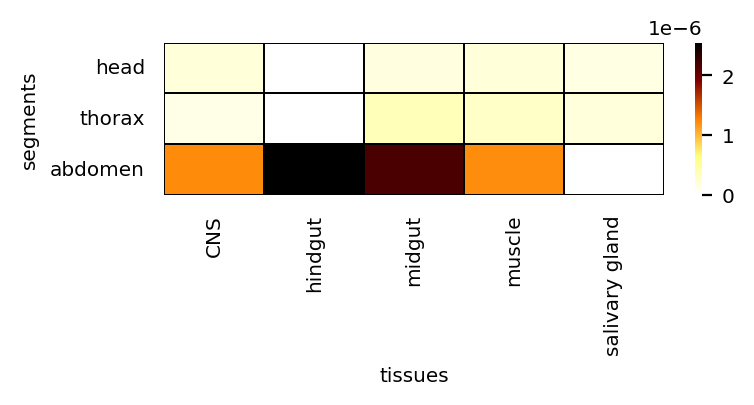

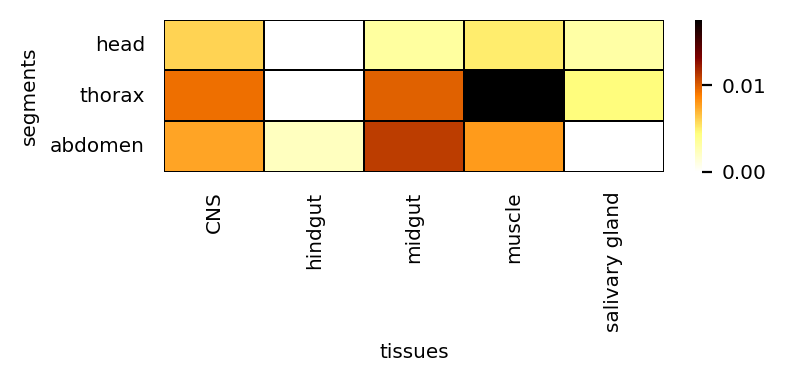

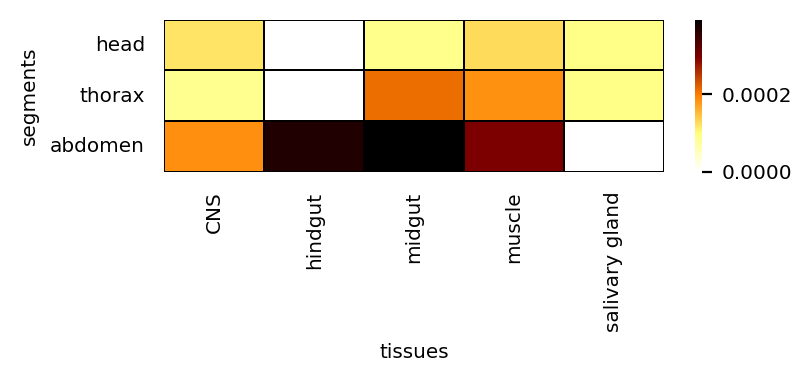

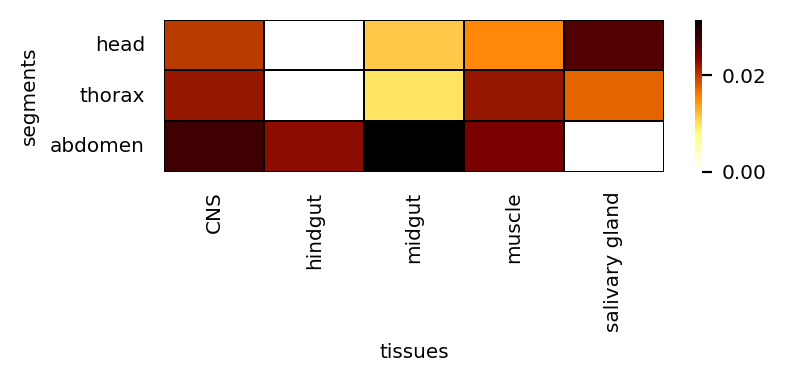

In [7]:
for mm in ['morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion']:
    morpho_data = germ_adata.obs[['anno_tissue_new', "segments", mm]]
    morpho_data = pd.DataFrame(morpho_data.groupby(by=["segments", "anno_tissue_new"]).mean())
    morpho_data.fillna(value=0, inplace=True)
    morpho_data["segments"] = [i for i, j in morpho_data.index]
    morpho_data["tissues"] = [j for i, j in morpho_data.index]
    morpho_data.index = range(len(morpho_data.index))
    morpho_data = pd.pivot_table(morpho_data, index="segments", columns="tissues", values=mm)
    morpho_data = morpho_data.loc[["head", "thorax", "abdomen"], :]
    f, ax = plt.subplots(figsize=(4, 1))
    sns.heatmap(data=morpho_data, cmap="afmhot_r", ax=ax, linewidths=0.1, linecolor="black", robust=True)
    plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_{mm}_segements_tissues_heatmap.pdf"), dpi=300, format="pdf", bbox_inches="tight")
    plt.show()

## Highly-migrated region of midgut

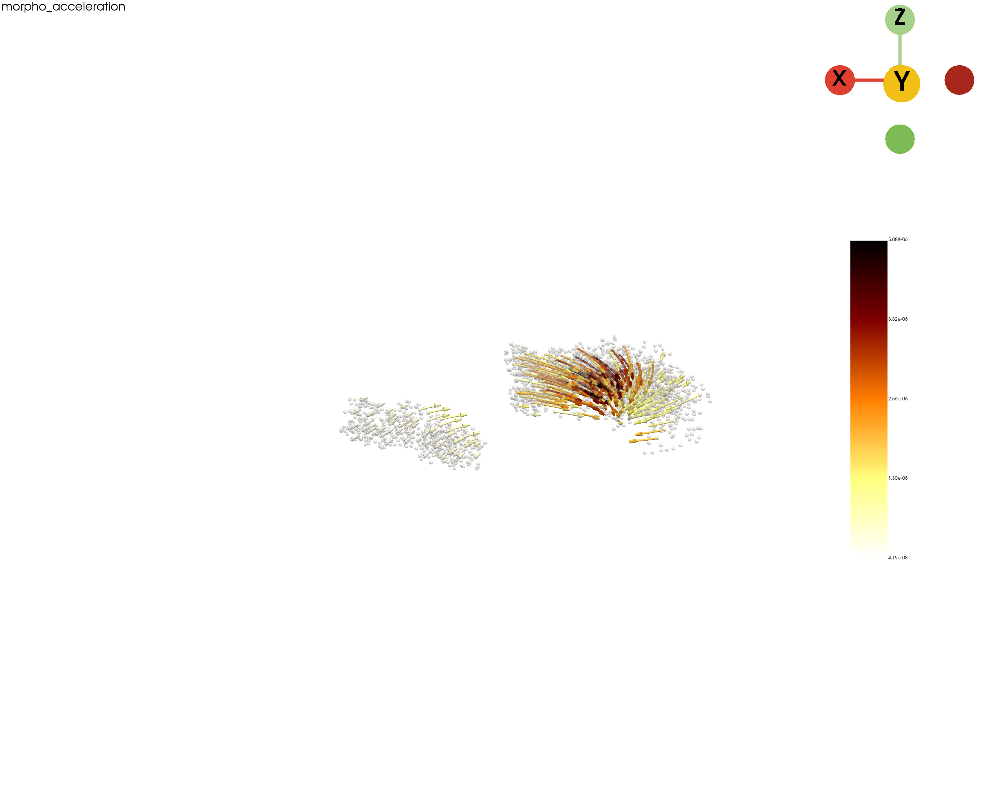

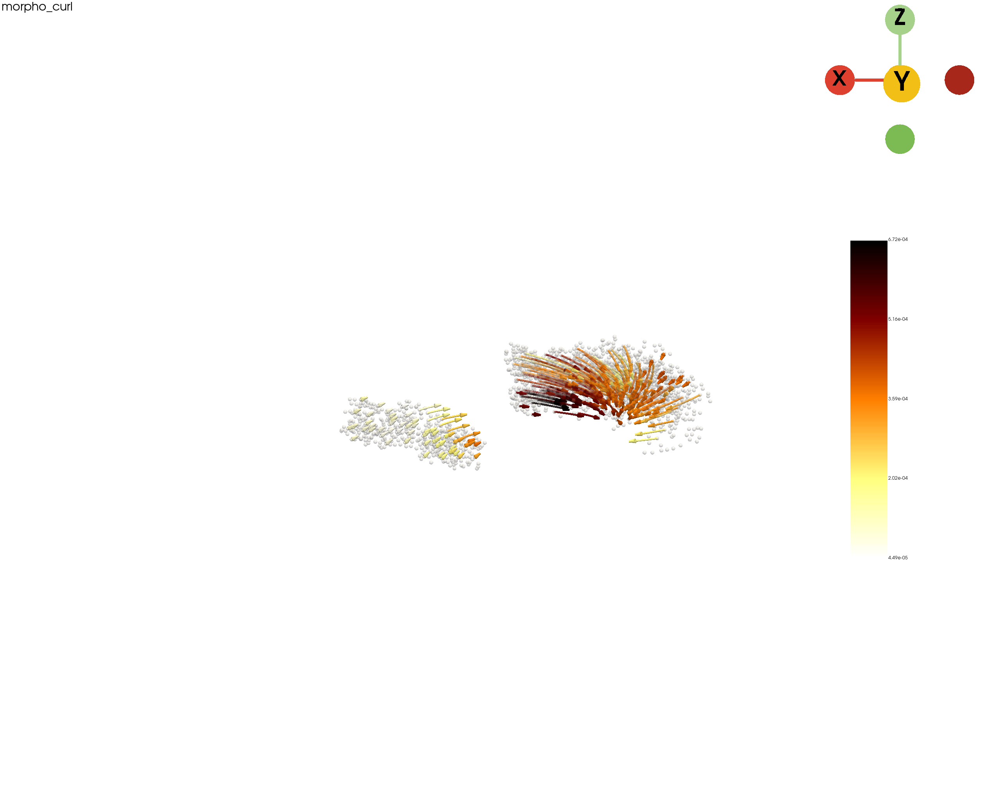

In [26]:
hm_adata = germ_adata[germ_adata.obs["anno_tissue_new"]=="midgut", :]
hm_adata = hm_adata[hm_adata.layers["X_counts"].sum(axis=1) !=0, hm_adata.layers["X_counts"].sum(axis=0) !=0]

hm_pc, _ = st.tdr.construct_pc(
    adata=hm_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue",
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",}
)
morphometrics_keys = ["morpho_acceleration", "morpho_curl"]
for mk in morphometrics_keys:
    mmvalue = hm_adata[hm_pc.point_data["obs_index"].tolist(), :].obs[mk].values
    st.tdr.add_model_labels(model=hm_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    sub_trajectory_model = trajectory_model.extract_points(list(map(lambda x: x in hm_adata.obs.index, np.asarray(trajectory_model.point_data["obs_index"]))))
    st.tdr.add_model_labels(
        model=sub_trajectory_model,
        key_added=mk,
        labels=np.asarray(hm_adata[np.asarray(sub_trajectory_model.point_data["obs_index"])].obs[mk]),
        where="point_data",
        inplace=True,
    )
    
    st.pl.three_d_plot(
        model=st.tdr.collect_models([hm_pc, sub_trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        off_screen=True,
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_highly_migration_midgut_{mk}_pc_trajectory_model.pdf"),
    )

## Highly-migrated region of muscle

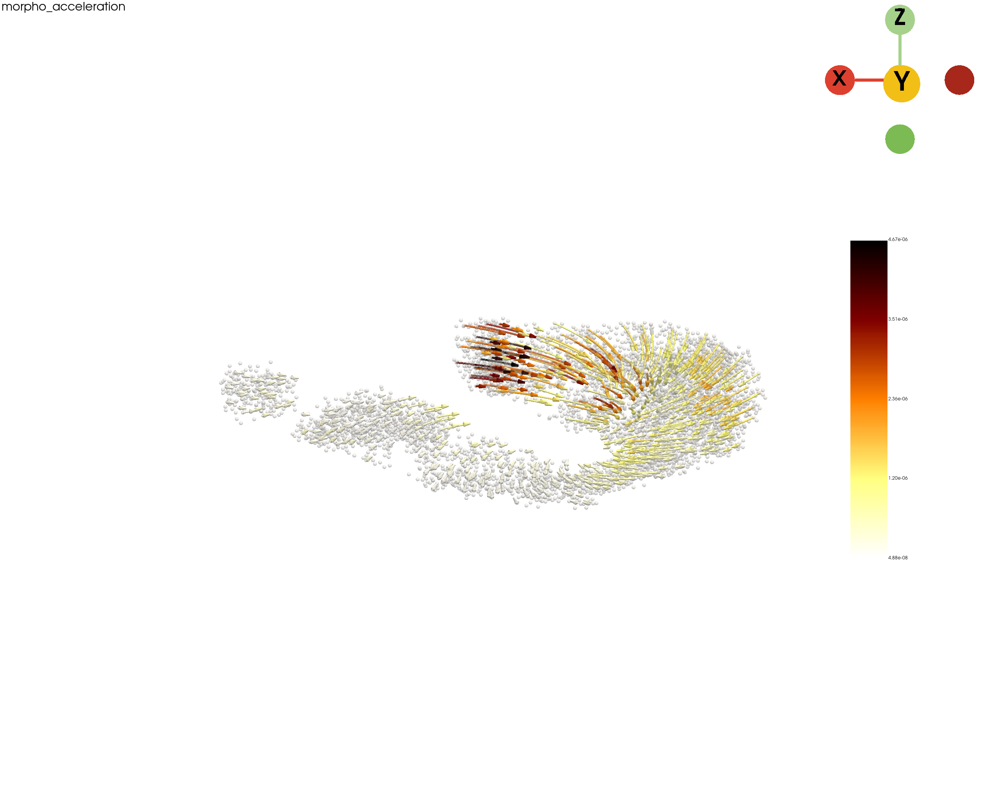

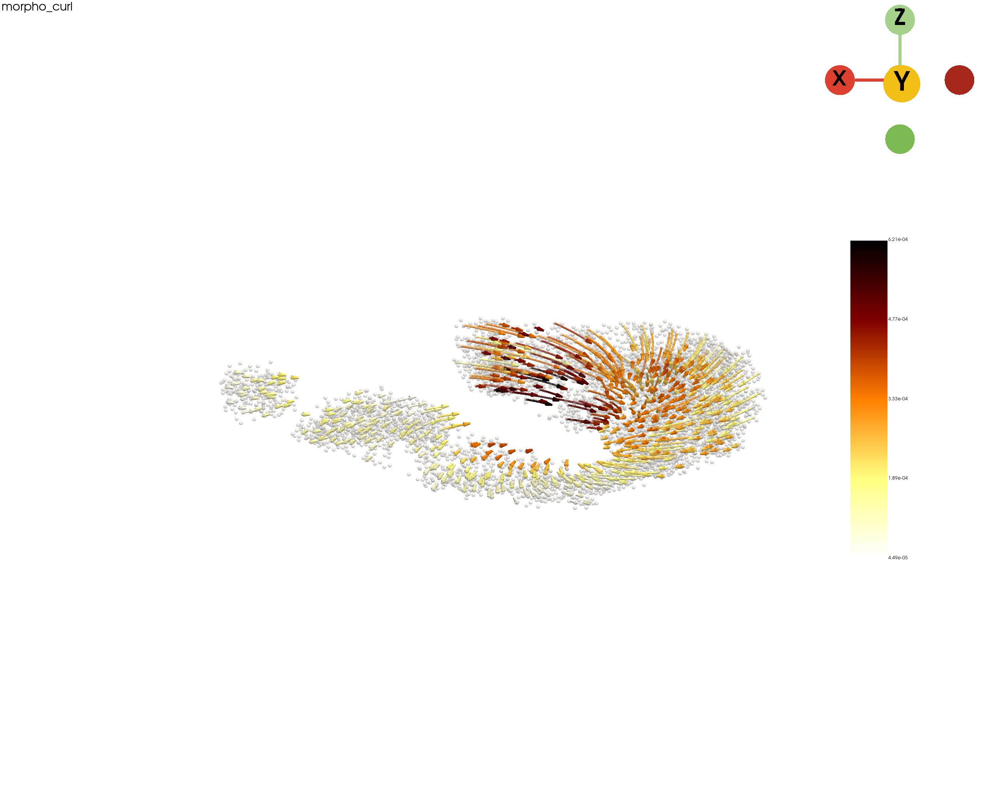

In [27]:
hm_adata = germ_adata[germ_adata.obs["anno_tissue_new"]=="muscle", :]
hm_adata = hm_adata[hm_adata.layers["X_counts"].sum(axis=1) !=0, hm_adata.layers["X_counts"].sum(axis=0) !=0]

hm_pc, _ = st.tdr.construct_pc(
    adata=hm_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue",
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",}
)
morphometrics_keys = ["morpho_acceleration", "morpho_curl"]
for mk in morphometrics_keys:
    mmvalue = hm_adata[hm_pc.point_data["obs_index"].tolist(), :].obs[mk].values
    st.tdr.add_model_labels(model=hm_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    sub_trajectory_model = trajectory_model.extract_points(list(map(lambda x: x in hm_adata.obs.index, np.asarray(trajectory_model.point_data["obs_index"]))))
    st.tdr.add_model_labels(
        model=sub_trajectory_model,
        key_added=mk,
        labels=np.asarray(hm_adata[np.asarray(sub_trajectory_model.point_data["obs_index"])].obs[mk]),
        where="point_data",
        inplace=True,
    )
    
    st.pl.three_d_plot(
        model=st.tdr.collect_models([hm_pc, sub_trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        off_screen=True,
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_highly_migration_muscle_{mk}_pc_trajectory_model.pdf"),
    )

## Highly-migrated region of CNS

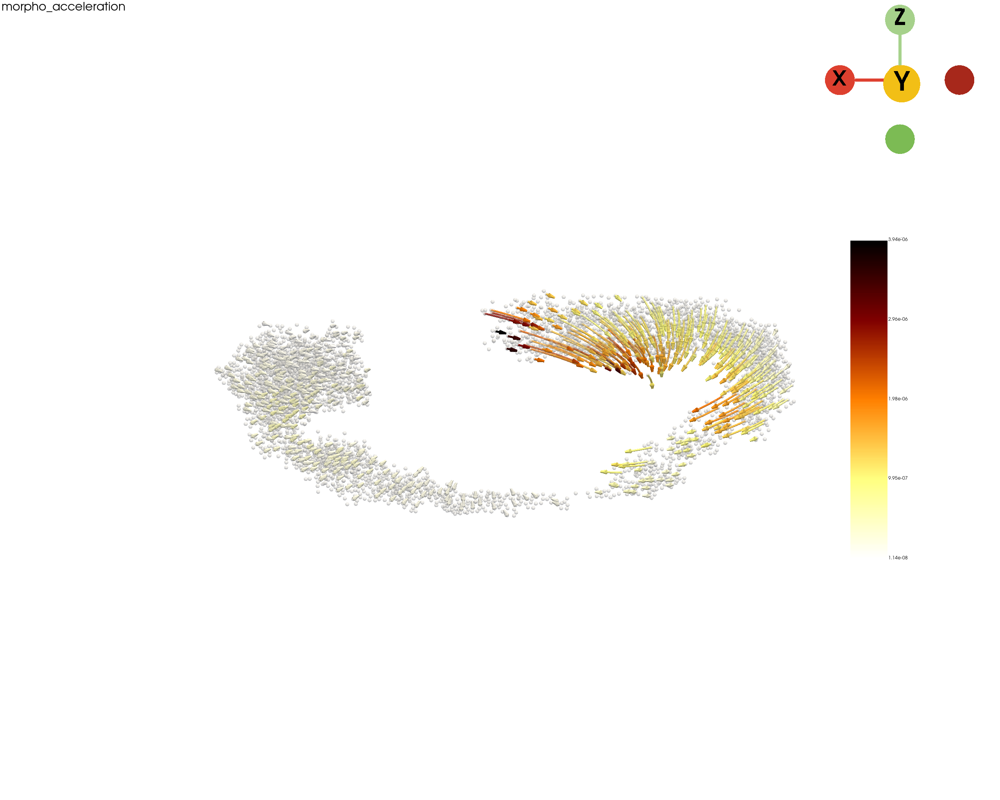

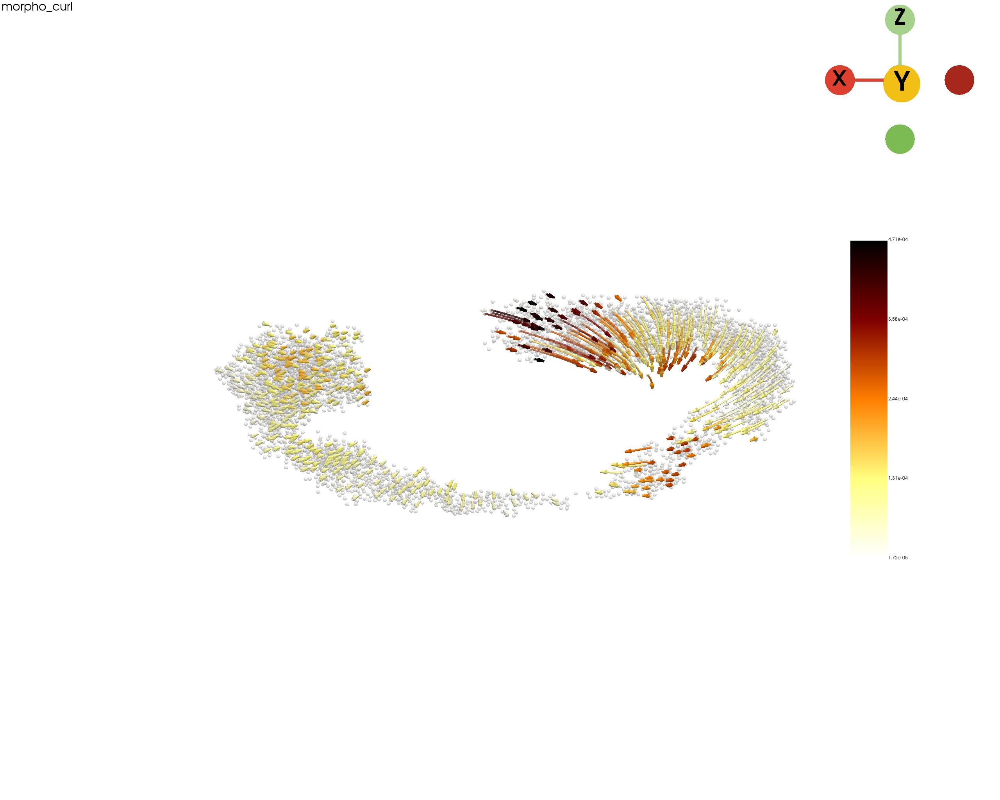

In [28]:
hm_adata = germ_adata[germ_adata.obs["anno_tissue_new"]=="CNS", :]
hm_adata = hm_adata[hm_adata.layers["X_counts"].sum(axis=1) !=0, hm_adata.layers["X_counts"].sum(axis=0) !=0]

hm_pc, _ = st.tdr.construct_pc(
    adata=hm_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue",
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",}
)
morphometrics_keys = ["morpho_acceleration", "morpho_curl"]
for mk in morphometrics_keys:
    mmvalue = hm_adata[hm_pc.point_data["obs_index"].tolist(), :].obs[mk].values
    st.tdr.add_model_labels(model=hm_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    sub_trajectory_model = trajectory_model.extract_points(list(map(lambda x: x in hm_adata.obs.index, np.asarray(trajectory_model.point_data["obs_index"]))))
    st.tdr.add_model_labels(
        model=sub_trajectory_model,
        key_added=mk,
        labels=np.asarray(hm_adata[np.asarray(sub_trajectory_model.point_data["obs_index"])].obs[mk]),
        where="point_data",
        inplace=True,
    )
    
    st.pl.three_d_plot(
        model=st.tdr.collect_models([hm_pc, sub_trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        off_screen=True,
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_highly_migration_CNS_{mk}_pc_trajectory_model.pdf"),
    )

## Highly-migrated region of hindgut

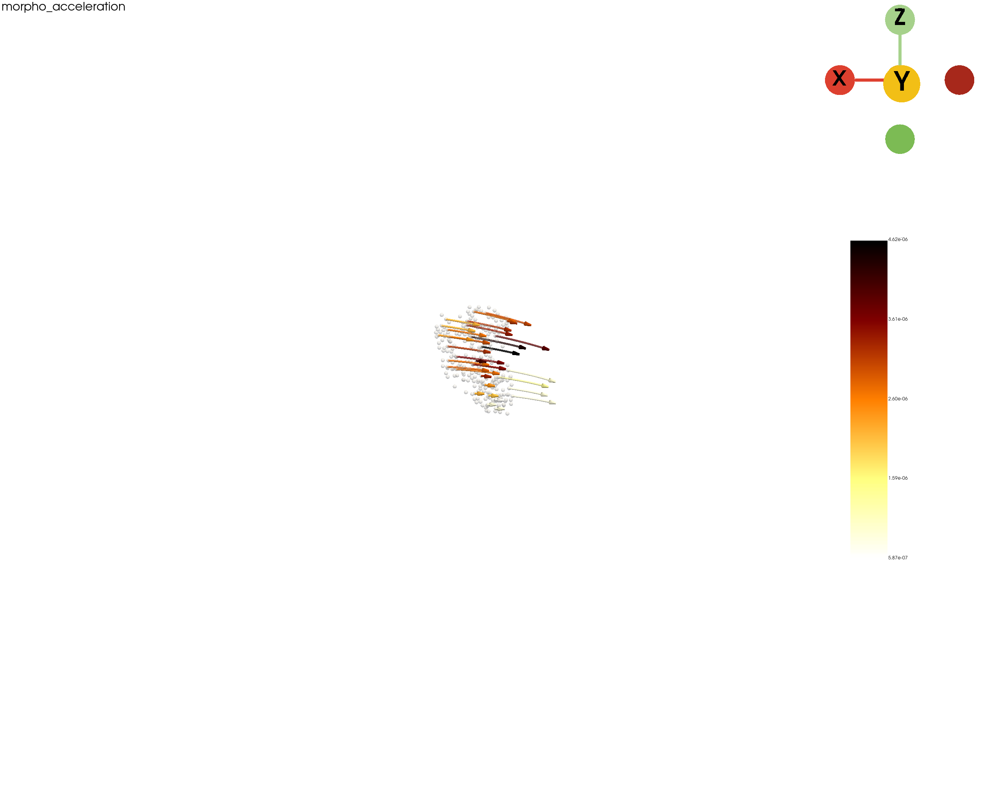

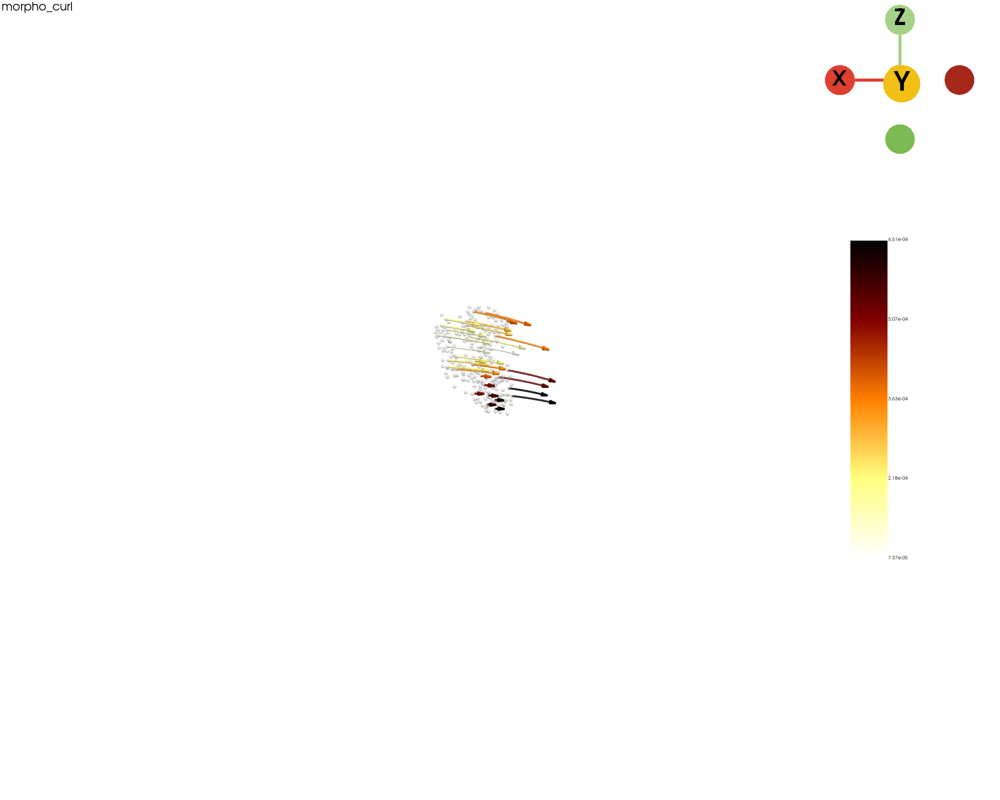

In [29]:
hm_adata = germ_adata[germ_adata.obs["anno_tissue_new"]=="hindgut", :]
hm_adata = hm_adata[hm_adata.layers["X_counts"].sum(axis=1) !=0, hm_adata.layers["X_counts"].sum(axis=0) !=0]

hm_pc, _ = st.tdr.construct_pc(
    adata=hm_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue",
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",}
)
morphometrics_keys = ["morpho_acceleration", "morpho_curl"]
for mk in morphometrics_keys:
    mmvalue = hm_adata[hm_pc.point_data["obs_index"].tolist(), :].obs[mk].values
    st.tdr.add_model_labels(model=hm_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    sub_trajectory_model = trajectory_model.extract_points(list(map(lambda x: x in hm_adata.obs.index, np.asarray(trajectory_model.point_data["obs_index"]))))
    st.tdr.add_model_labels(
        model=sub_trajectory_model,
        key_added=mk,
        labels=np.asarray(hm_adata[np.asarray(sub_trajectory_model.point_data["obs_index"])].obs[mk]),
        where="point_data",
        inplace=True,
    )
    
    st.pl.three_d_plot(
        model=st.tdr.collect_models([hm_pc, sub_trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        off_screen=True,
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_highly_migration_hindgut_{mk}_pc_trajectory_model.pdf"),
    )

## CCI between muscle and midgut/hindgut/CNS

In [40]:
cci_germ_adata = germ_adata[germ_adata.obs["anno_tissue_new"].isin(["CNS", "midgut", "muscle", "hindgut"]), :].copy()
cci_germ_adata = cci_germ_adata[:, ~cci_germ_adata.var.index.map(lambda x: str(x).startswith("RpS"))]
cci_germ_adata = cci_germ_adata[:, ~cci_germ_adata.var.index.map(lambda x: str(x).startswith("RpL"))]
cci_germ_adata = cci_germ_adata[:, ~cci_germ_adata.var.index.map(lambda x: str(x).startswith("mt:"))]
cci_germ_adata.uns["__type"] = "UMI"

cci_germ_adata.X = cci_germ_adata.layers["X_counts"]
cci_germ_adata = cci_germ_adata[cci_germ_adata.X.sum(axis=1) !=0, cci_germ_adata.X.sum(axis=0) !=0]
sc.pp.normalize_total(cci_germ_adata)
sc.pp.log1p(cci_germ_adata)

cci_germ_pc,_ = st.tdr.construct_pc(cci_germ_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue")
cci_germ_adata

AnnData object with n_obs × n_vars = 12225 × 7998
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho', 'glm_degs', 'log1p', 'pp', '__type'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

In [43]:
weights_graph, distance_graph, adata = st.tl.weighted_spatial_graph(
    cci_germ_adata,
    spatial_key="3d_align_spatial",
    n_neighbors=30,
    fixed='n_neighbors',
)

|-----> <insert> spatial_connectivities to obsp in AnnData Object.
|-----> <insert> spatial_distances to obsp in AnnData Object.
|-----> <insert> spatial_neighbors to uns in AnnData Object.
|-----> <insert> spatial_neighbors.indices to uns in AnnData Object.
|-----> <insert> spatial_neighbors.params to uns in AnnData Object.
|-----> <insert> spatial_weights to obsp in AnnData Object.


|-----> <insert> spatial_connectivities to obsp in AnnData Object.
|-----> <insert> spatial_distances to obsp in AnnData Object.
|-----> <insert> spatial_neighbors to uns in AnnData Object.
|-----> <insert> spatial_neighbors.indices to uns in AnnData Object.
|-----> <insert> spatial_neighbors.params to uns in AnnData Object.
|-----> <insert> spatial_weights to obsp in AnnData Object.
|-----> 
--- 4 labels, 12225 samples ---
initalized (5,) index ptr: [0 0 0 0 0]
initalized (12225,) indices: [0 0 0 ... 0 0 0]
initalized (12225,) data: [1 1 1 ... 1 1 1]

|-----> Deep copying AnnData object and working on the new copy. Original AnnData object will not be modified.
|-----> Matrix multiplying labels x weights x labels-transpose, shape (4, 12225) x (12225, 12225) x (12225, 4).


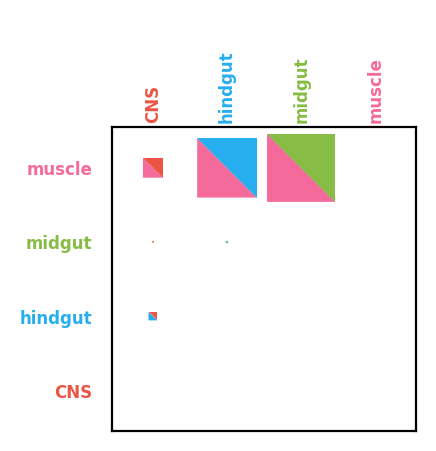

In [44]:
fig = st.pl.plot_connections(
    adata,
    cat_key='anno_tissue_new',
    spatial_key="3d_align_spatial",
    save_show_or_return='return',
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "amnioserosa": "#bdcf32",},
    title_str=" ",
    title_fontsize=6,
    label_fontsize=6,
    figsize=(4, 2),
)
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germband_highly_migration_cci_tissue_connections.pdf"), dpi=300, format="pdf", bbox_inches="tight")

In [38]:
# hc_adata = germ_adata[germ_adata.obs["backbone_nodes"] >= 21, :]
hc_adata = germ_adata[germ_adata.obs["segments"]=="abdomen", :]
hc_adata = hc_adata[hc_adata.layers["X_counts"].sum(axis=1) !=0, hc_adata.layers["X_counts"].sum(axis=0) !=0]

hc_germ_pc, _ = st.tdr.construct_pc(
    adata=hc_adata, spatial_key="3d_align_spatial", groupby="anno_tissue_new", key_added="tissue",
    colormap={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b", "salivary gland": "#ef9b20",}
)
# hc_germ_pc = st.tdr.interactive_rectangle_clip(model=hc_germ_pc, key="tissue", invert=True)[0]
hc_adata = hc_adata[np.asarray(hc_germ_pc.point_data["obs_index"]), :].copy()
del hc_adata.uns
hc_adata

AnnData object with n_obs × n_vars = 7889 × 8080
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

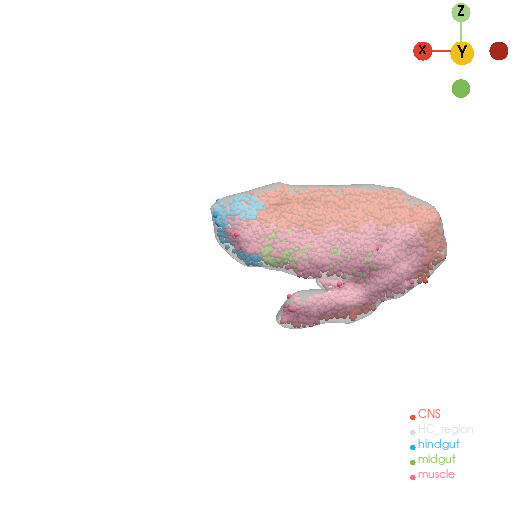

In [43]:
hc_germ_mesh, _, _ = st.tdr.construct_surface(
    pc=hc_germ_pc, key_added="tissue", label="HC_region", color="gainsboro", alpha=0.6,
    cs_method="marching_cube", cs_args={"mc_scale_factor": 0.8}, smooth=3000, scale_factor=1.0)

st.pl.three_d_plot(
    model=st.tdr.collect_models([hc_germ_mesh, hc_germ_pc]),
    key="tissue",
    model_style=["surface", "points"],
    model_size=5,
    opacity=[1, 1],
    cpo=cpo,
    jupyter="static",
)

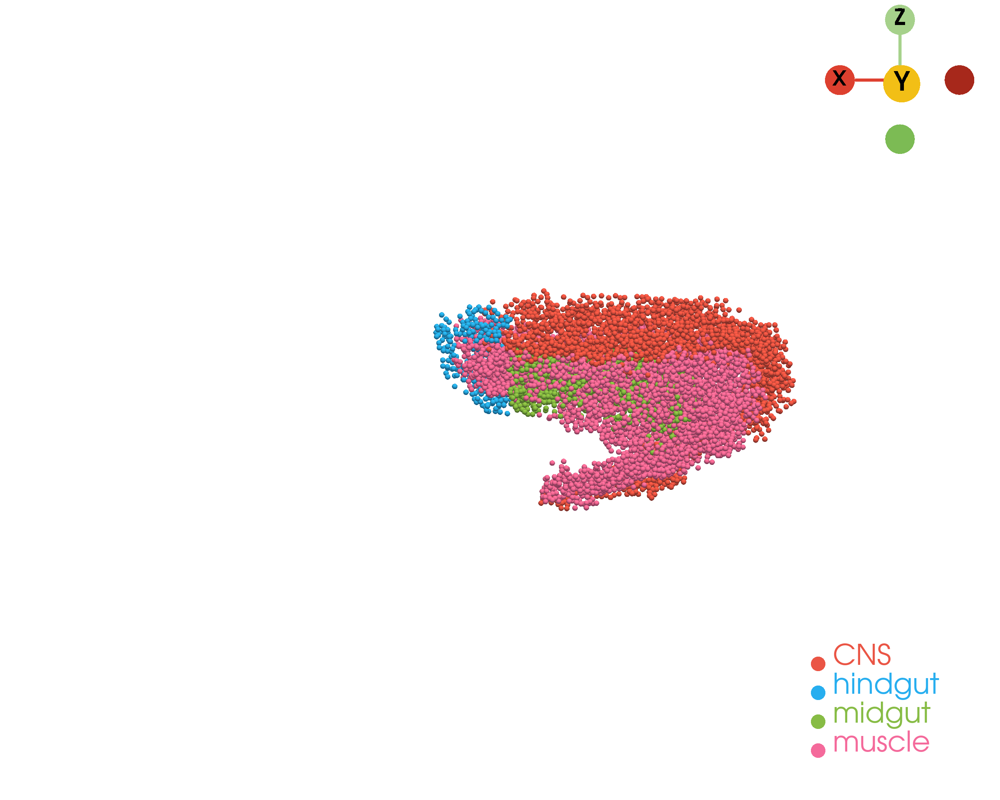

In [44]:
st.pl.three_d_plot(
        model=hc_germ_pc,
        key="tissue",
        jupyter="static",
        cpo=cpo,
        background="white",
        window_size=(2560, 2048),
        model_style="points",
        model_size=14,
        filename=os.path.join(out_image_path, f"{sample_id}_germband_high_acceleration_pc_model.pdf"),
    )

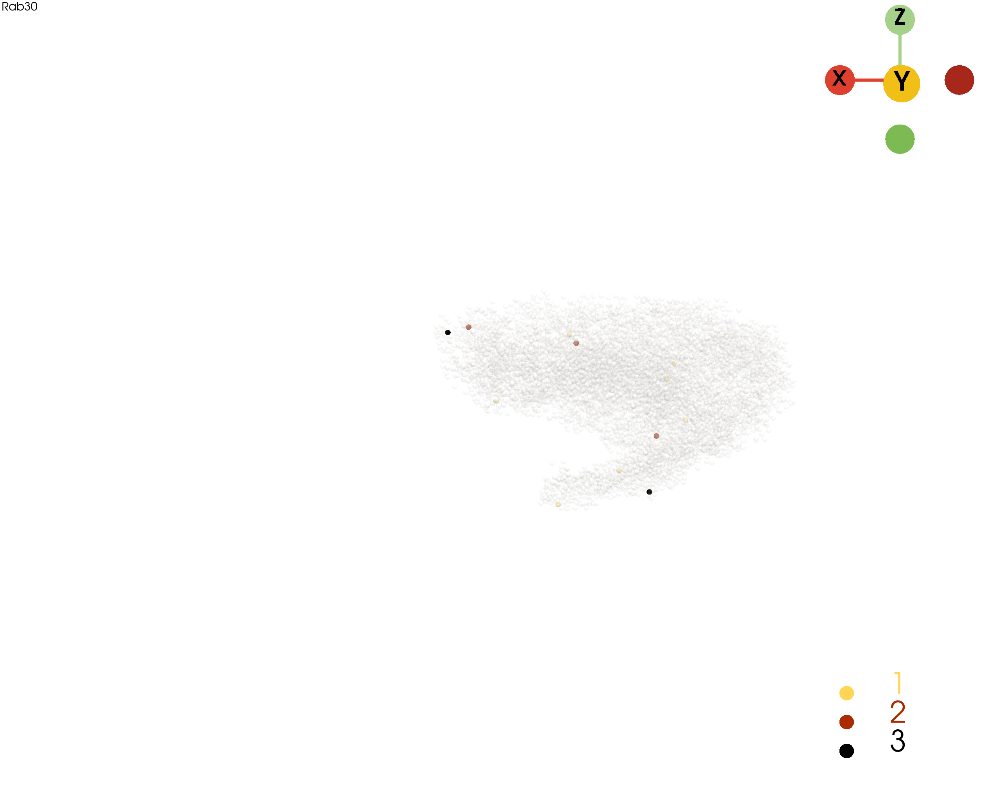

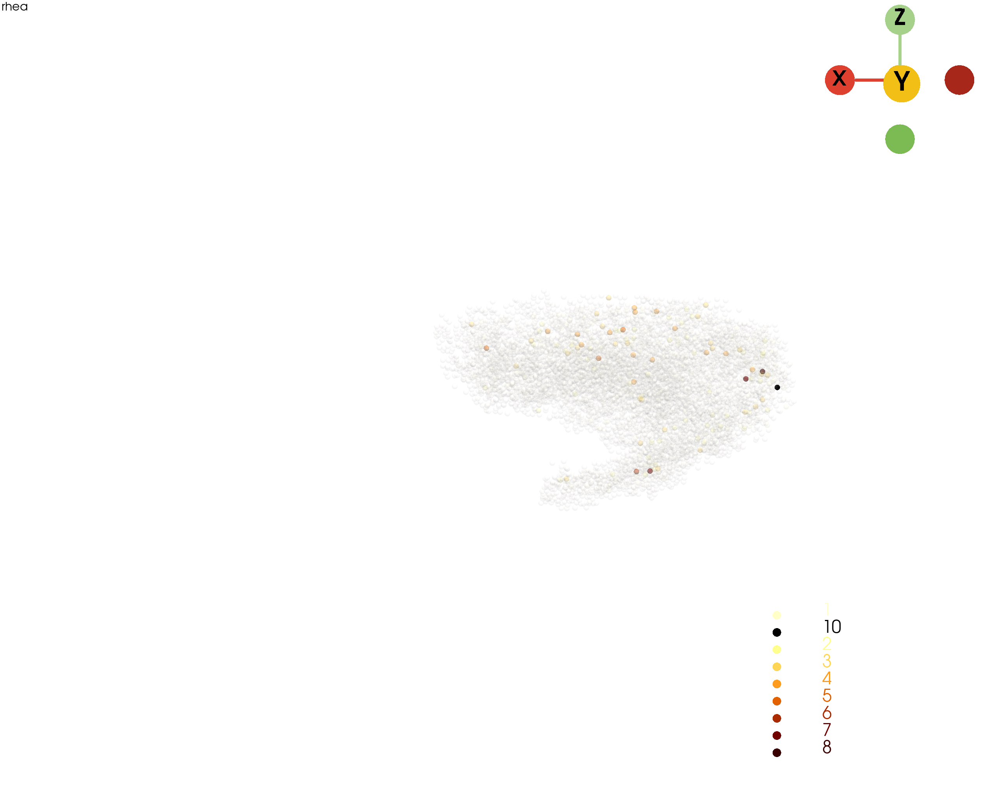

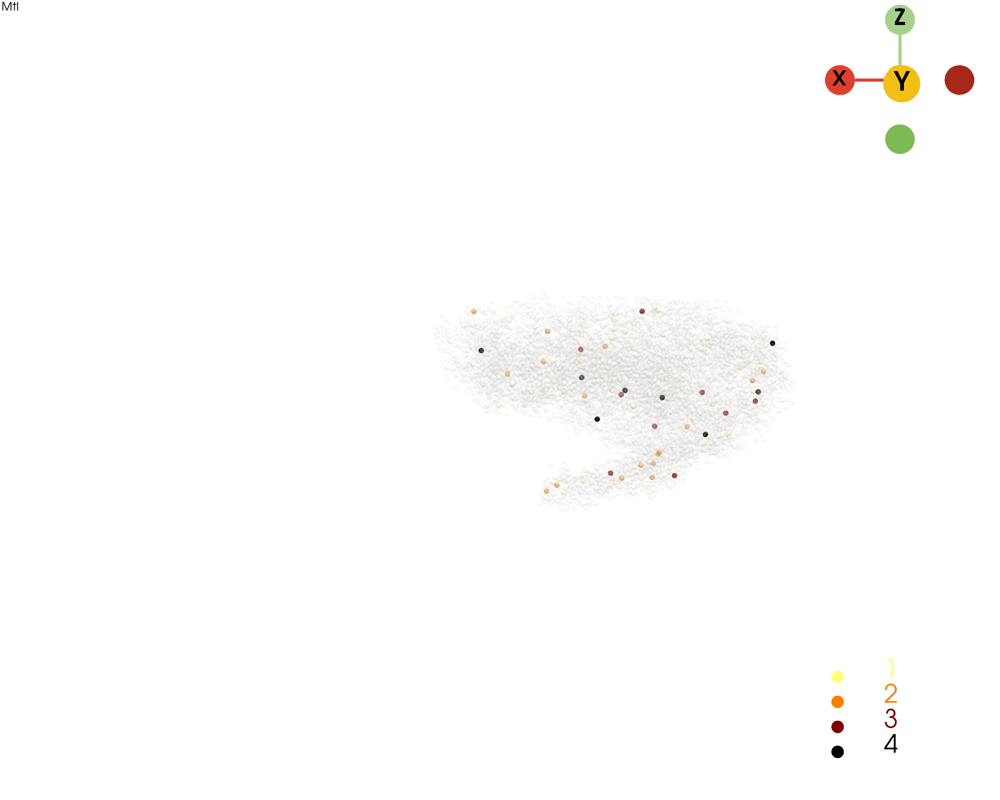

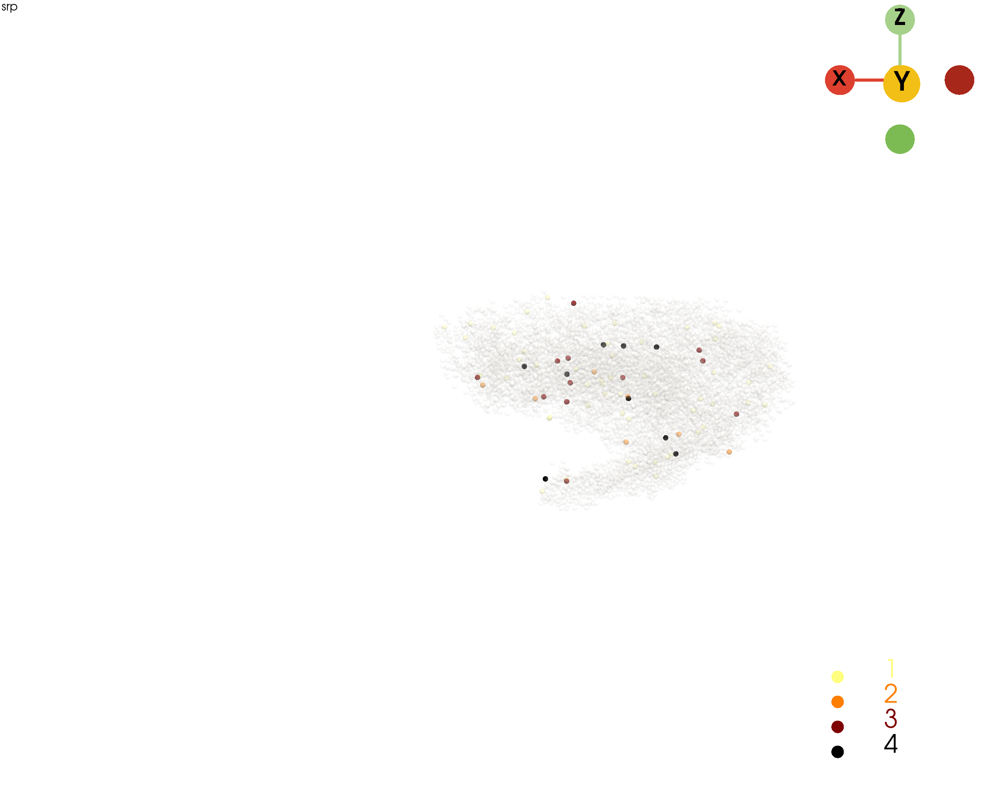

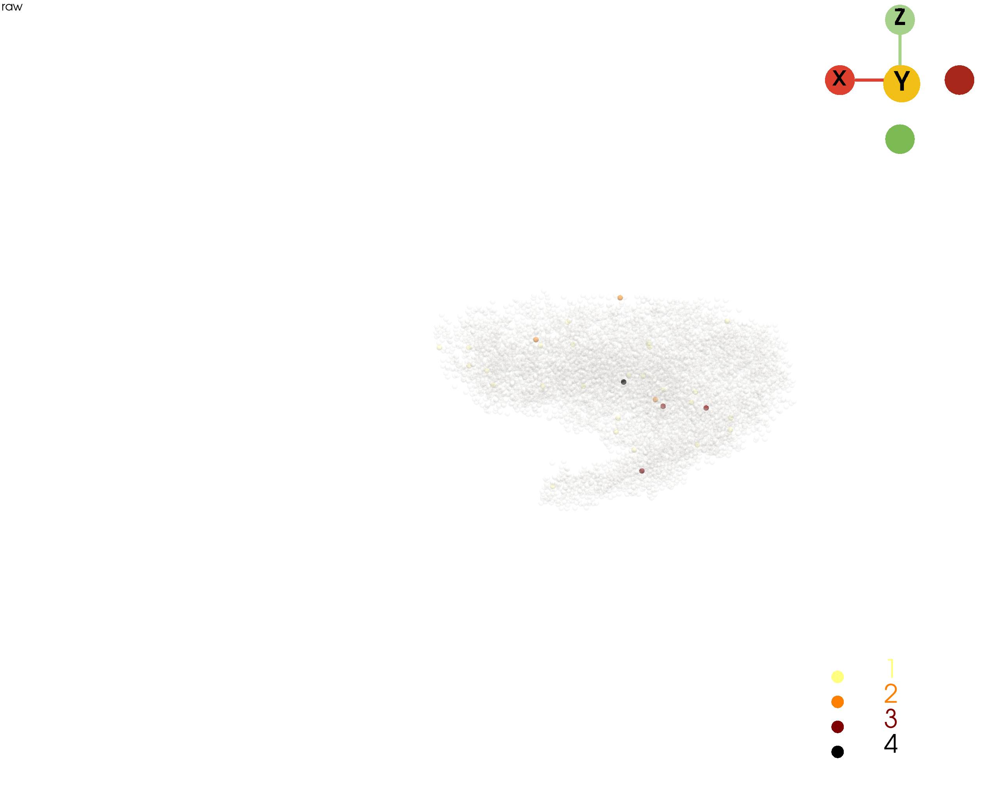

...

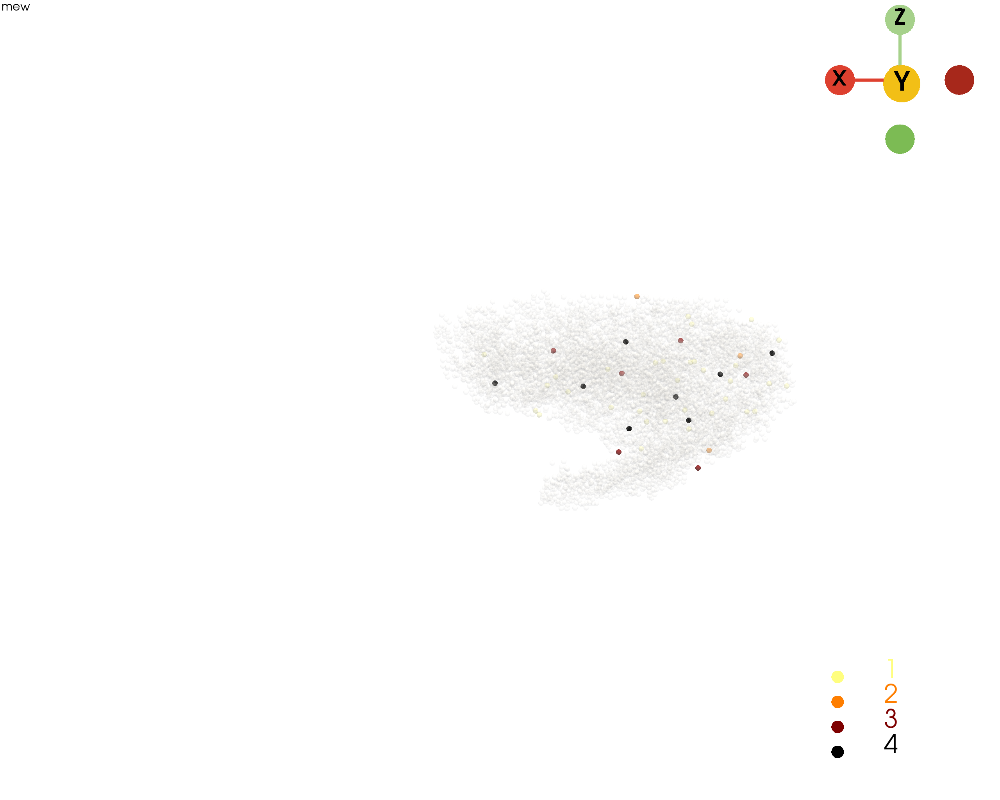

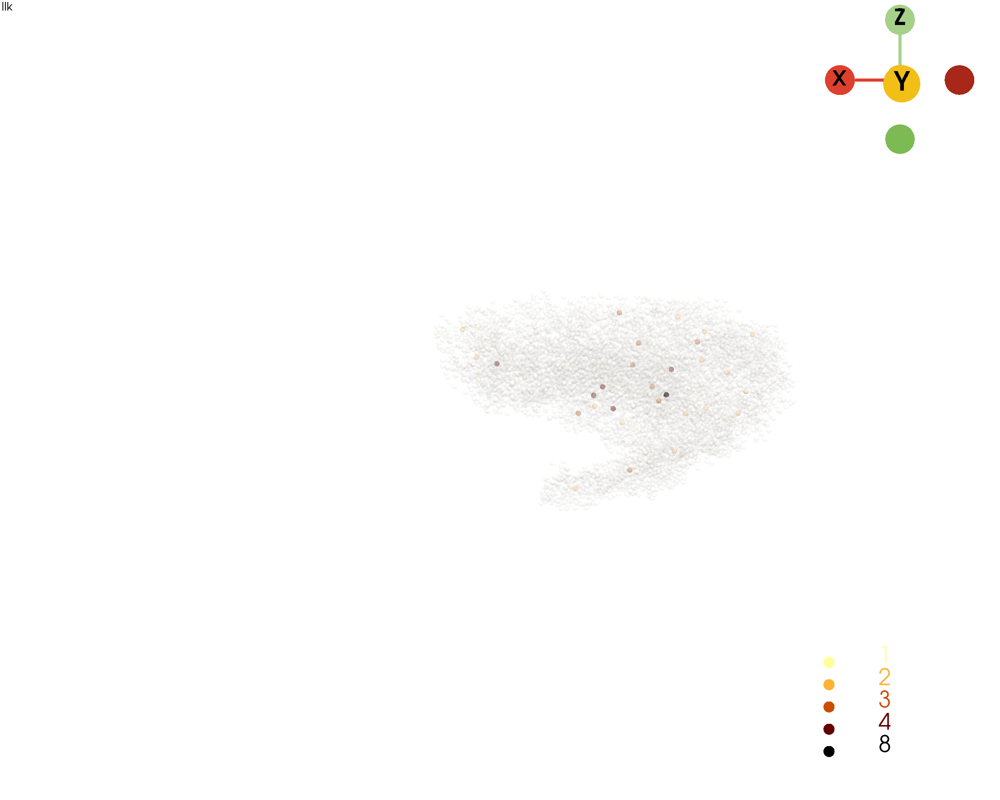

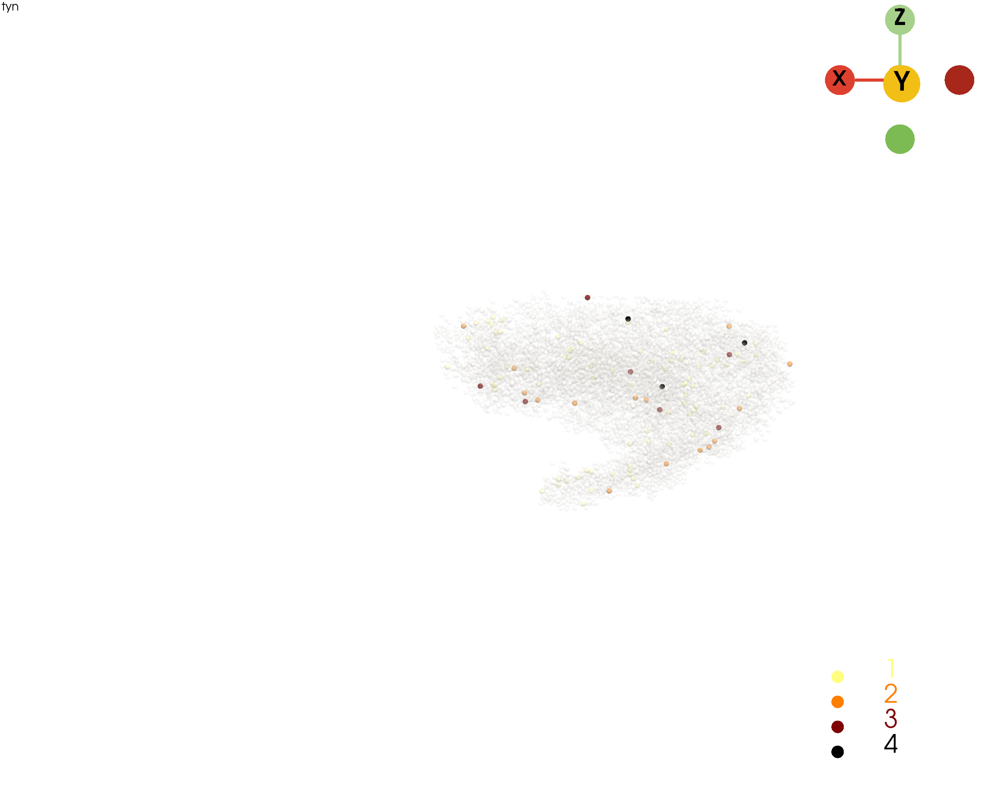

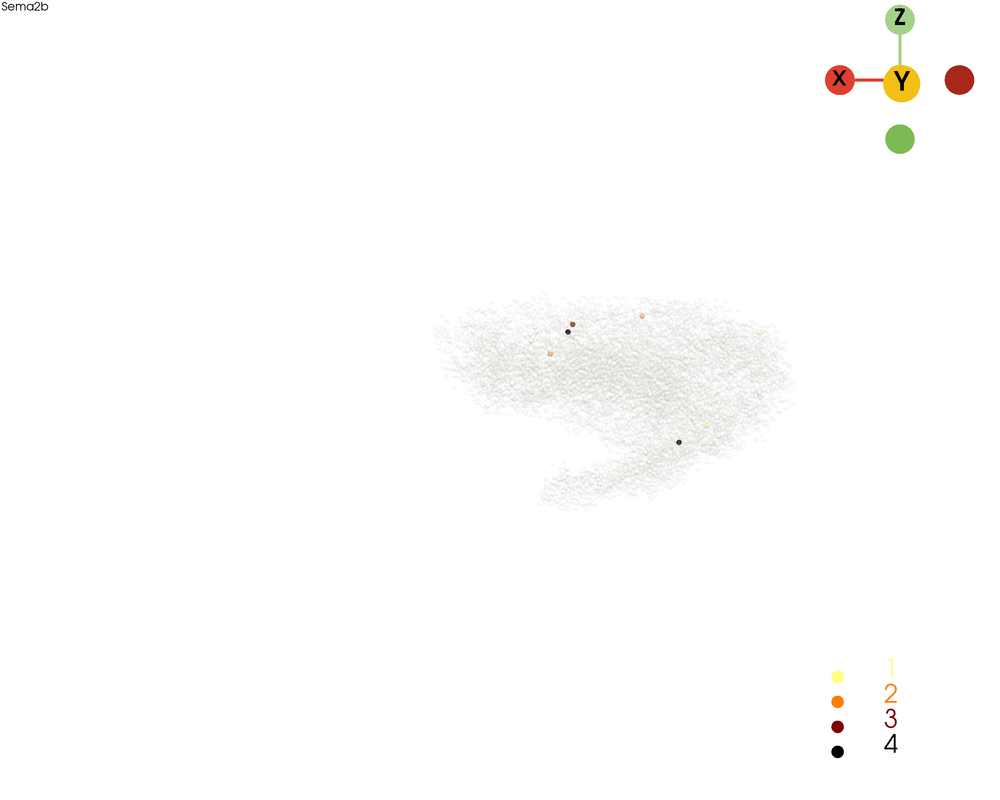

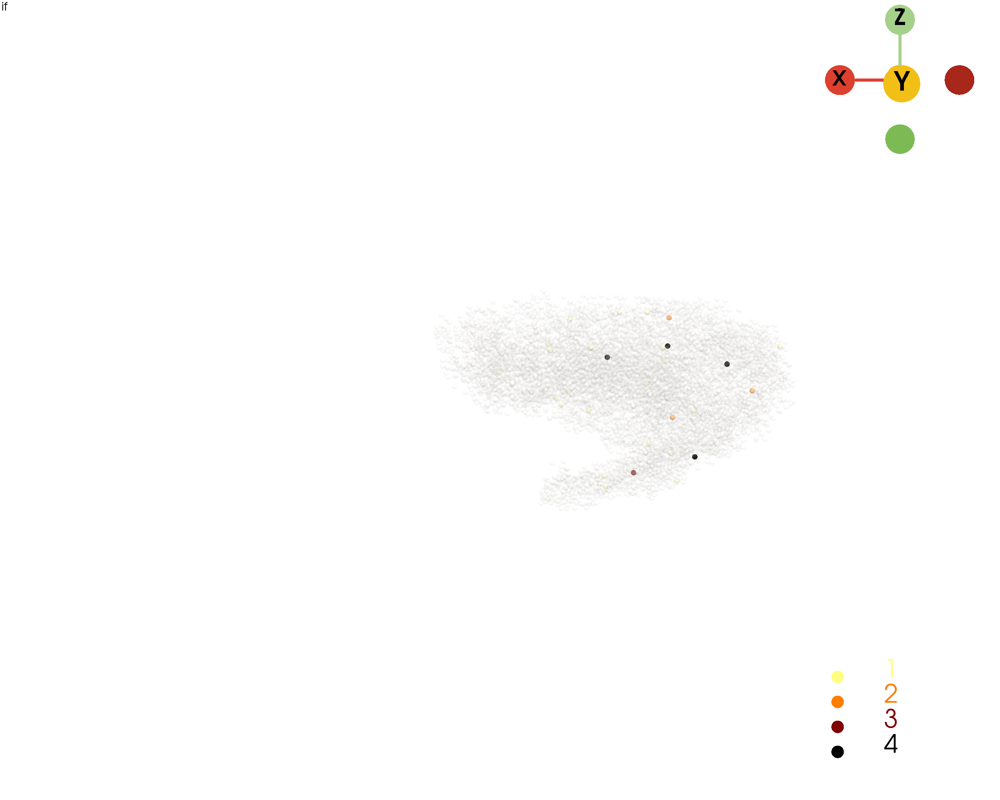

In [51]:
GNs = [
    "Rab30", "rhea", "Mtl", "srp", "raw", "peb", "ecd", "EcR", "Egfr", "ush", "Rac2", "Rac1", "tup", "yrt", "POSH", "sr", "InR", "ena",
    "Ndg","Ret","scb","mys","Zasp52","muskelin","Pten","Itgbn","Fit2","Fit1","m","mew","Ilk","tyn","Sema2b","if"
]
for gn in GNs:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    pc_index=hc_germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    
    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.1] = 0.1
    add_model_labels(model=hc_germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=hc_germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter="static",
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
    )

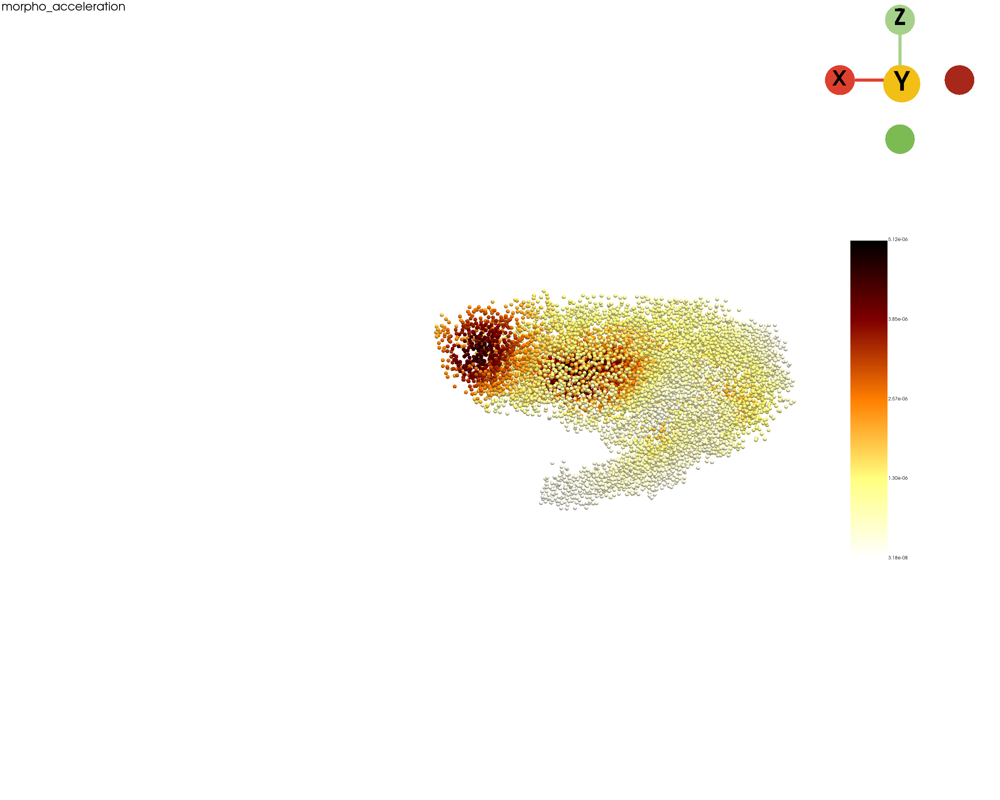

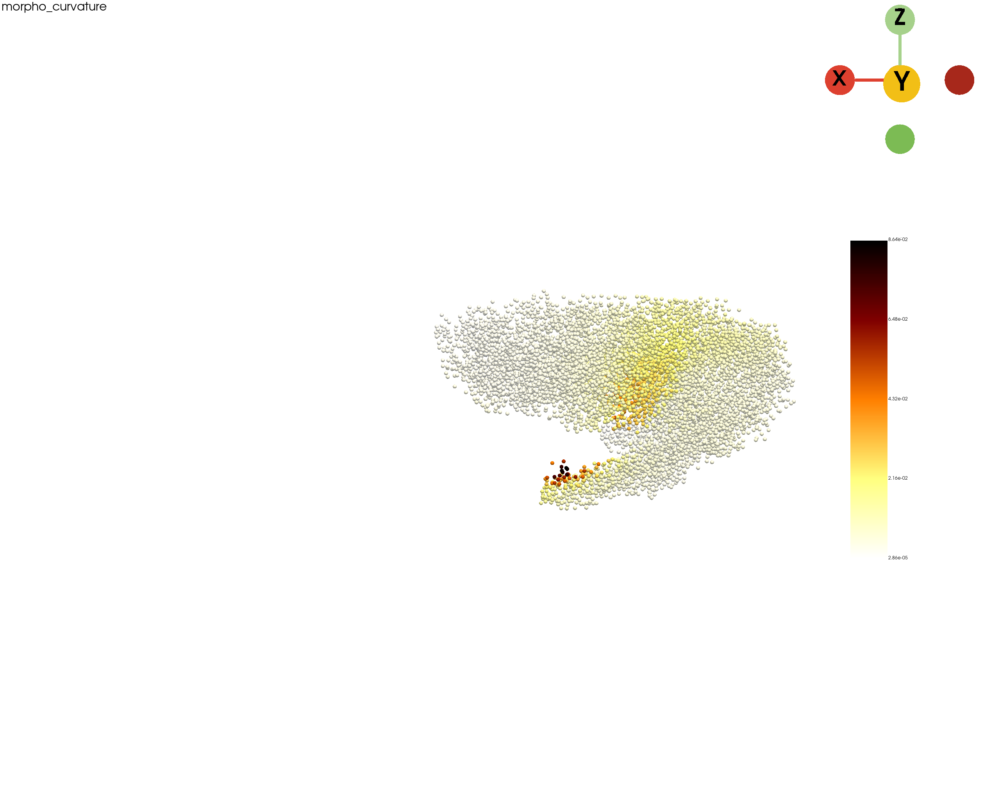

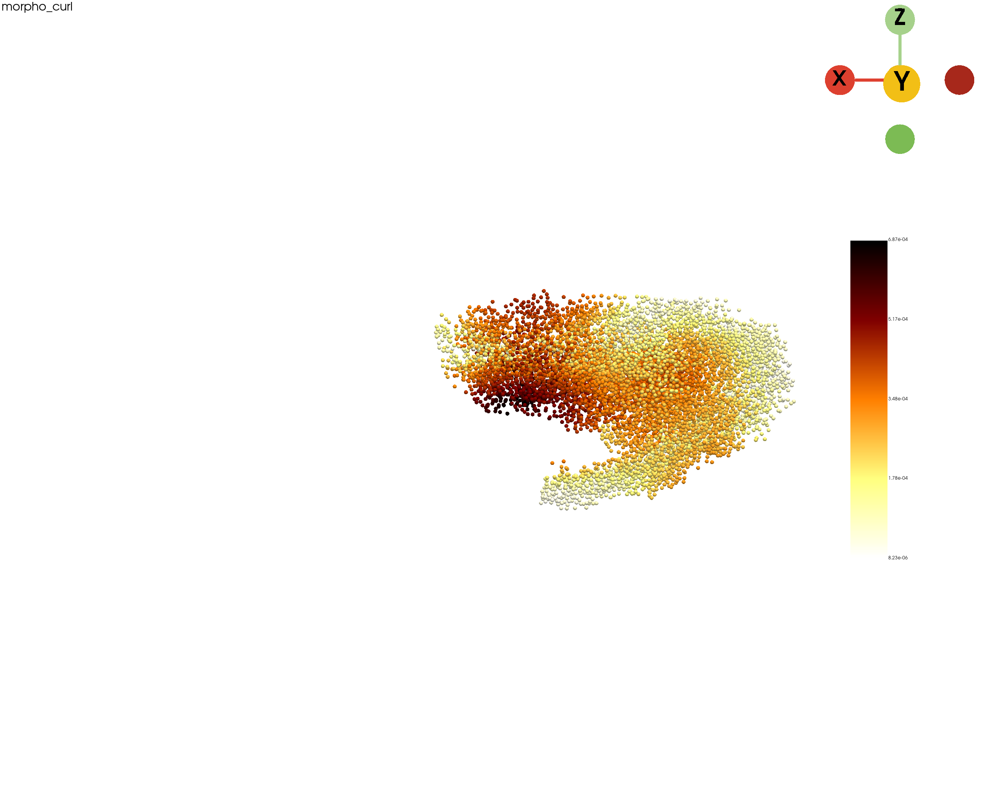

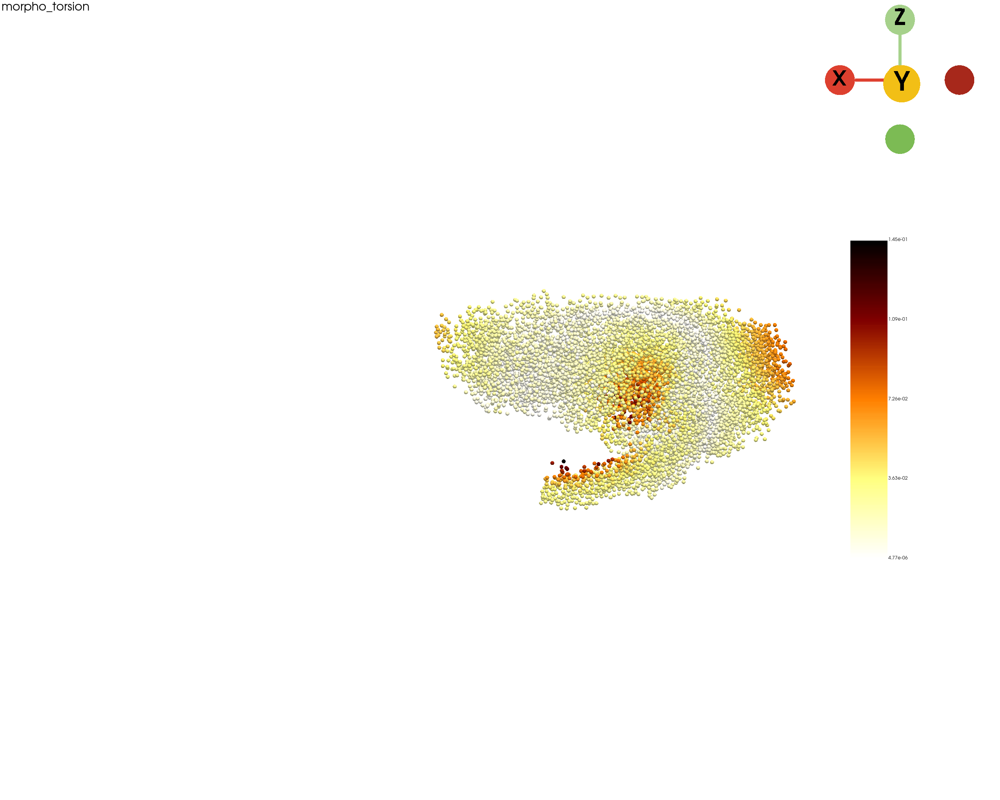

In [52]:
morphometrics_keys = ["morpho_acceleration", "morpho_curvature", "morpho_curl", "morpho_torsion"]
for mk in morphometrics_keys:
    pc_index=hc_germ_pc.point_data["obs_index"].tolist()
    mmvalue = hc_adata[pc_index, :].obs[mk].values
    st.tdr.add_model_labels(model=hc_germ_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=hc_germ_pc,
        key=mk,
        model_style="points",
        model_size=10,
        opacity=1,
        colormap="afmhot_r", # Spectral_r
        show_legend=True,
        jupyter="static",
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_high_acceleration_raw_{mk}_pc_model.pdf"),
    )

## Re-calculate morphofield

In [53]:
st.tdr.morphofield(
    adata=hc_adata,
    spatial_key="3d_align_spatial",
    V_key="V_cells_mapping",
    key_added="VecFld_morpho",
    NX=np.asarray(hc_germ_mesh.points),
    inplace=True,
)
hc_germ_pc.point_data["vectors"] = hc_adata.uns["VecFld_morpho"]["V"]
hc_germ_mesh.point_data["vectors"] = hc_adata.uns["VecFld_morpho"]["grid_V"]

|-----? The length of [  0 100 200 300 400] is different from 10, using `np.range(restart_num) * 100
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] completed [0.0965s]
|-----> [morphofield] in progress: 100.0000%
|-----> [morphofield] finished [2659.0817s]


|-----? The number of start_points is more than 500. You may want to lower the max number of arrows to draw.


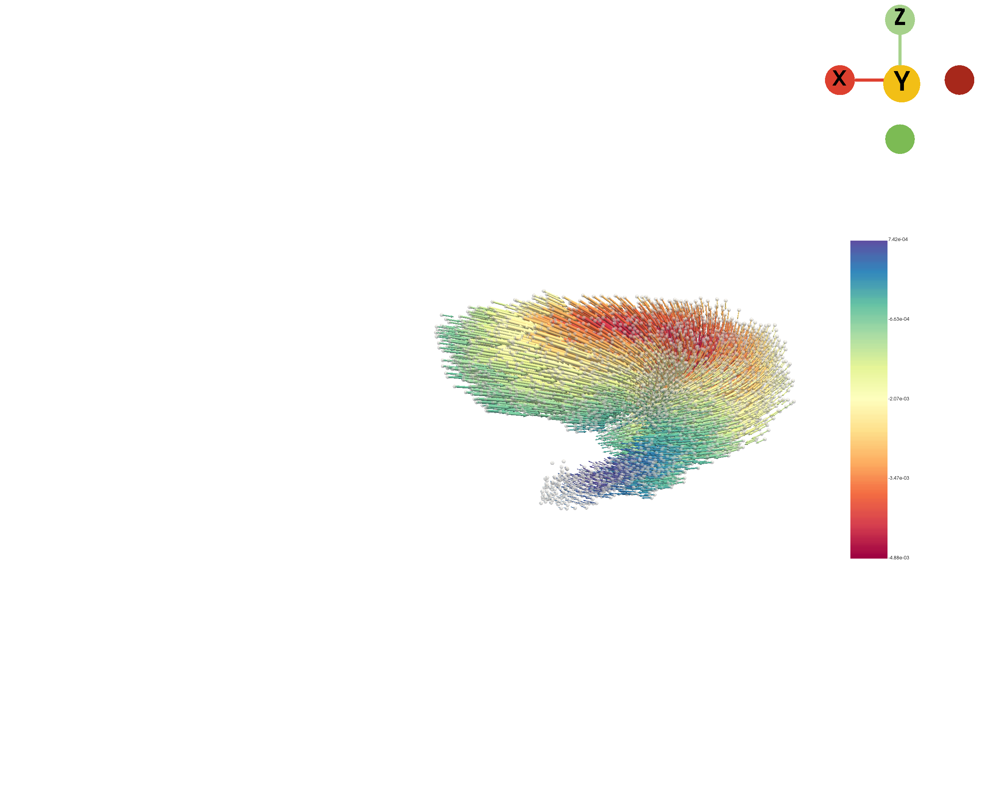

In [55]:
vector_arrows1,_ = st.tdr.construct_field(
    model=hc_germ_pc,
    vf_key="vectors",
    arrows_scale_key="vectors",
    n_sampling=None,
    factor=3000,
    key_added="v_arrows",
    label=hc_germ_pc.point_data["vectors"][:, 2].flatten(),
    color= "rainbow",
)
st.pl.three_d_plot(
    model=st.tdr.collect_models([hc_germ_pc, vector_arrows1]),
    key=["tissue", "v_arrows"],
    colormap=["gainsboro", "Spectral"],
    opacity=[0.5, 1],
    model_style=["points", "surface"],
    model_size=[10, 5],
    jupyter="static",
    background="white",
    window_size=(2560, 2048),
    cpo=cpo,
)

In [56]:
st.tdr.morphopath(
    adata=hc_adata,
    # layer="log1p_X",
    vf_key="VecFld_morpho",
    key_added="fate_morpho",
    t_end=10000,
    interpolation_num=50,
    cores=20
)

|-----> [Running TRN] in progress: 100.0000%|-----> [Running TRN] completed [18.9275s]


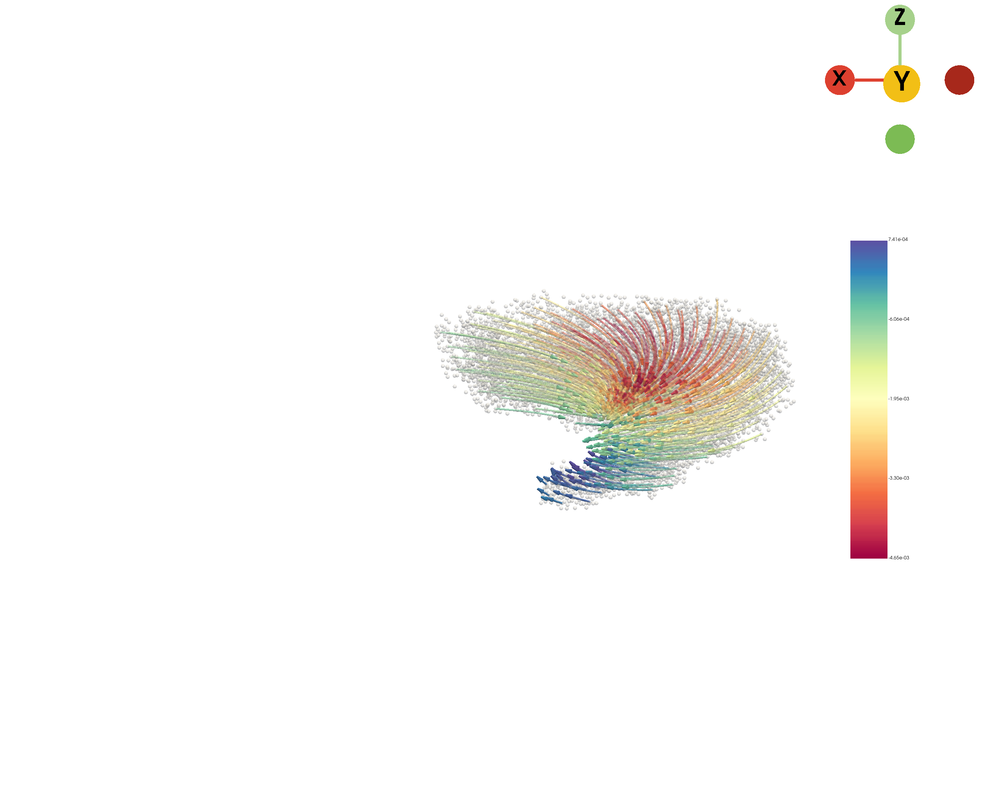

In [59]:
trajectory_model, _ = st.tdr.construct_trajectory(
    adata=hc_adata,
    fate_key="fate_morpho",
    n_sampling=500,
    sampling_method="trn",
    key_added="obs_index",
    label=np.asarray(hc_adata.obs.index), # stage1_tissue_adata.uns["VecFld_morpho"]["V"][:, 2].flatten(),
)
hc_adata.obs["V_z"] = hc_adata.uns["VecFld_morpho"]["V"][:, 2].flatten()
st.tdr.add_model_labels(
    model=trajectory_model,
    key_added="trajectory",
    labels=np.asarray(hc_adata[np.asarray(trajectory_model.point_data["obs_index"])].obs["V_z"]),
    colormap="Spectral",
    where="point_data",
    inplace=True,
)
st.pl.three_d_plot(
    model=st.tdr.collect_models([hc_germ_pc, trajectory_model]),
    key=["tissue", "trajectory"],
    opacity=[0.5, .5],
    model_style=["points", "wireframe"],
    model_size=[10, 5],
    colormap=["gainsboro", "Spectral"],
    jupyter="static",
    background="white",
    window_size=(2560, 2048),
    cpo=cpo,
    filename=os.path.join(out_image_path, f"{sample_id}_germband_high_acceleration_trajectory_model.pdf"),
)

In [60]:
st.tdr.morphofield_velocity(adata=hc_adata, vf_key="VecFld_morpho", key_added="morpho_velocity",)
st.tdr.morphofield_acceleration(adata=hc_adata, vf_key="VecFld_morpho", key_added="morpho_acceleration",)
st.tdr.morphofield_curvature(adata=hc_adata, vf_key="VecFld_morpho", key_added="morpho_curvature")
st.tdr.morphofield_curl(adata=hc_adata, vf_key="VecFld_morpho", key_added="morpho_curl",)
st.tdr.morphofield_torsion(adata=hc_adata, vf_key="VecFld_morpho", key_added="morpho_torsion",)
hc_adata

|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0773s]
|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0482s]
|-----> [Calculating curvature] in progress: 100.0000%|-----> [Calculating curvature] completed [0.0761s]


Calculating 3-D curl: 100%|██████████| 7889/7889 [00:00<00:00, 82909.95it/s]


|-----> [Calculating acceleration] in progress: 100.0000%|-----> [Calculating acceleration] completed [0.0410s]


Calculating torsion: 100%|██████████| 7889/7889 [00:00<00:00, 176013.02it/s]


AnnData object with n_obs × n_vars = 7889 × 8080
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho', 'fate_morpho', 'morpho_torsion'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

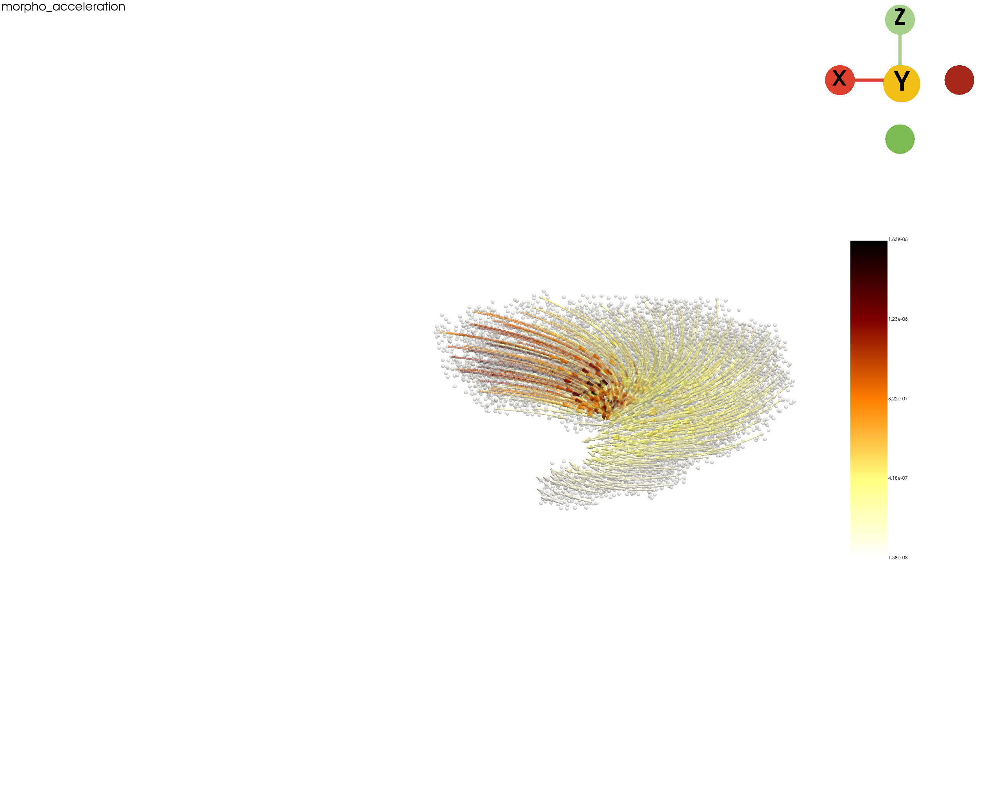

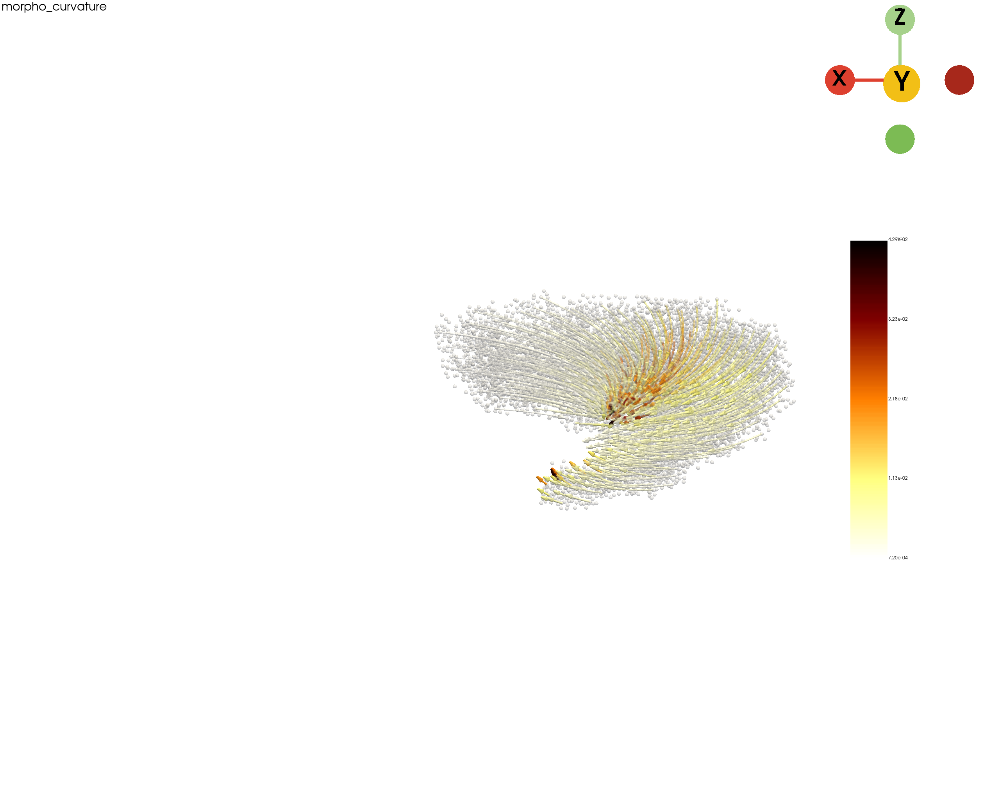

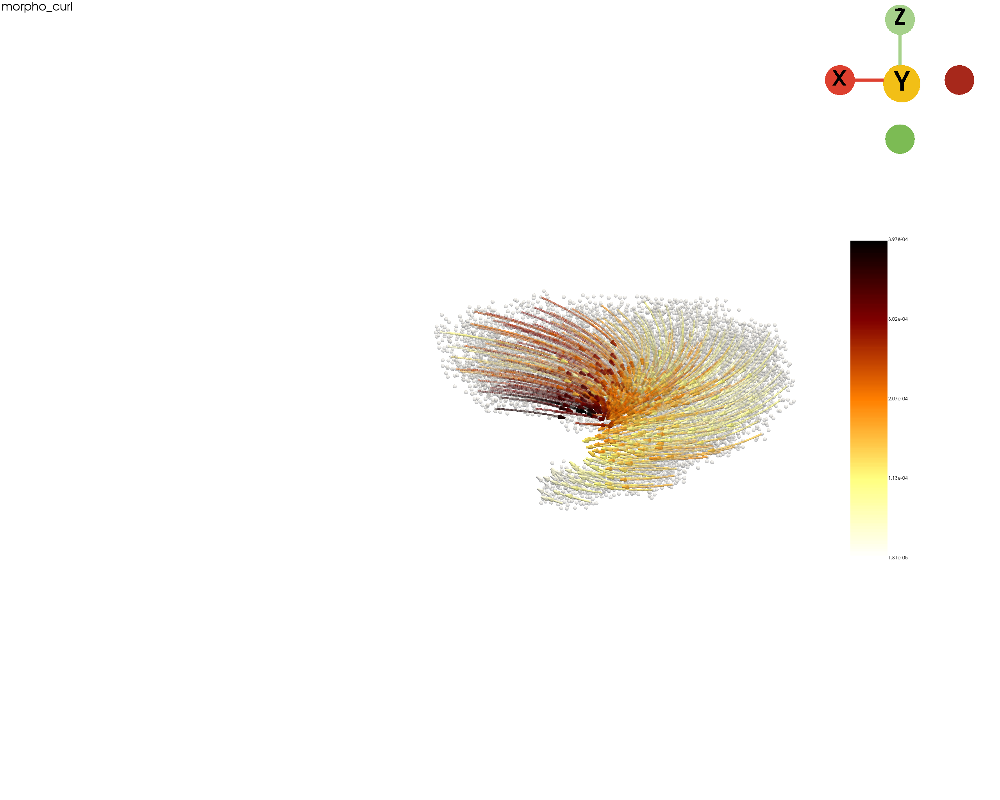

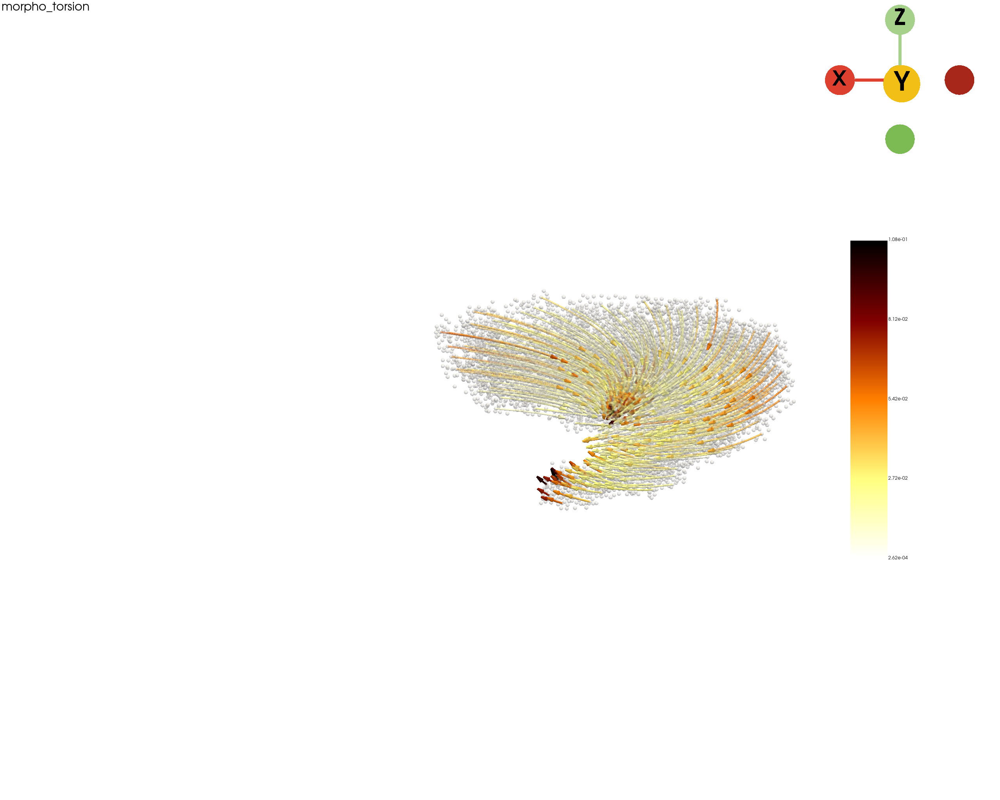

In [61]:
morphometrics_keys = ["morpho_acceleration", "morpho_curvature", "morpho_curl", "morpho_torsion"]
for mk in morphometrics_keys:
    mmvalue = hc_adata[hc_germ_pc.point_data["obs_index"].tolist(), :].obs[mk].values
    st.tdr.add_model_labels(model=hc_germ_pc, labels=mmvalue, key_added=mk, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.tdr.add_model_labels(
        model=trajectory_model,
        key_added=mk,
        labels=np.asarray(hc_adata[np.asarray(trajectory_model.point_data["obs_index"])].obs[mk]),
        where="point_data",
        inplace=True,
    )
    
    st.pl.three_d_plot(
        model=st.tdr.collect_models([hc_germ_pc, trajectory_model]),
        key=["tissue", mk],
        model_style=["points", "wireframe"],
        model_size=[10, 5],
        opacity=[0.5, 0.5],
        colormap=["gainsboro", "afmhot_r"],
        show_legend=True,
        jupyter="static",
        off_screen=True,
        background="white",
        cpo=cpo,
        window_size=(2560, 2048),
        text=mk,
        filename=os.path.join(out_image_path, f"{sample_id}_high_acceleration_{mk}_pc_trajectory_model.pdf"),
    )

## Save the anndata objects and models

In [62]:
del hc_adata.uns["fate_morpho"], hc_adata.uns["morpho_torsion"]
hc_adata.write_h5ad(f"h5ad/{sample_id}_germband_high_acceleration.h5ad", compression="gzip")
hc_adata

AnnData object with n_obs × n_vars = 7889 × 8080
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes', 'backbone_scc', 'segments', 'morpho_acceleration', 'morpho_curvature', 'morpho_curl', 'morpho_torsion'
    uns: 'VecFld_morpho'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'morpho_acceleration', 'morpho_curl', 'morpho_curvature', 'morpho_velocity', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

In [63]:
st.tdr.save_model(model=hc_germ_pc, filename=f"morpho_models/germband_high_acceleration_morphometrics_pc_model.vtk")
st.tdr.save_model(model=hc_germ_mesh, filename=f"morpho_models/germband_high_acceleration_morphometrics_mesh_model.vtk")
st.tdr.save_model(model=trajectory_model, filename=f"morpho_models/germband_high_acceleration_morphofield_trajectory_model.vtk")

## Curvature 

In [5]:
hc_adata = st.read_h5ad(f"h5ad/{sample_id}_germ_layer_high_acceleration_v4.h5ad")
hc_germ_pc = st.tdr.read_model("morpho_models/germ_layer_high_acceleration_morphometrics_pc_model.vtk")
hc_germ_mesh = st.tdr.read_model("morpho_models/germ_layer_high_acceleration_morphometrics_mesh_model.vtk")
trajectory_model = st.tdr.read_model("morpho_models/germ_layer_high_acceleration_morphofield_trajectory_model.vtk")

In [34]:
out_image_path = os.path.join(out_image_path, "hc_curvature")

In [45]:
hc_adata.X= hc_adata.layers["X_counts"].copy()
sc.pp.normalize_total(hc_adata)
sc.pp.log1p(hc_adata)

In [46]:
st.tl.glm_degs(
    adata=hc_adata,
    fullModelFormulaStr=f'~cr(morpho_curvature, df=3)',
    key_added="glm_degs",
    qval_threshold=0.01,
    llf_threshold=-100,
)
print(hc_adata.uns["glm_degs"]["glm_result"])

|-----? Gene expression matrix must be normalized by the size factor, please check if the input gene expression matrix is correct.If you don't have the size factor normalized gene expression matrix, please run `dynamo.pp.normalize_cell_expr_by_size_factors(skip_log = True)`.
|-----> [Detecting genes via Generalized Additive Models (GAMs)] in progress: 100.0000%
|-----> [Detecting genes via Generalized Additive Models (GAMs)] finished [404.4926s]
       status family  log-likelihood          pval          qval
Ance       ok    NB2    -1455.111206  0.000000e+00  0.000000e+00
otp        ok    NB2     -196.977051  7.635688e-29  3.801141e-26
Acbp5      ok    NB2     -303.118866  1.837106e-23  1.463255e-19
SpdS       ok    NB2     -722.483459  2.754042e-14  1.096797e-10
elav       ok    NB2    -1082.632935  1.078153e-12  2.862496e-09
...       ...    ...             ...           ...           ...
fne        ok    NB2     -319.979675  9.163265e-05  8.881344e-03
Hr4        ok    NB2     -339.

In [47]:
glm_data = hc_adata.uns["glm_degs"]["glm_result"]
glm_data= glm_data.loc[glm_data["log-likelihood"] >= -800, :]
# glm_data= glm_data.loc[glm_data["pval"] >= 1e-10, :]
glm_data= glm_data.loc[glm_data["pval"] <= 1e-5, :]
glm_data

,status,family,log-likelihood,pval,qval
otp,ok,NB2,-196.977051,7.635688e-29,3.801141e-26
Acbp5,ok,NB2,-303.118866,1.837106e-23,1.463255e-19
SpdS,ok,NB2,-722.483459,2.754042e-14,1.096797e-10
tap,ok,NB2,-348.792145,2.614010e-11,1.224740e-08
nerfin-1,ok,NB2,-446.458832,8.797062e-12,1.751715e-08
lncRNA:CR45388,ok,NB2,-415.984131,2.096925e-09,7.953338e-07
Ppn,ok,NB2,-341.785553,2.767258e-09,1.001873e-06
Abd-B,ok,NB2,-607.095520,7.749906e-10,1.028800e-06
peb,ok,NB2,-500.327057,1.236054e-08,1.230646e-05
neo,ok,NB2,-152.144775,1.720372e-08,1.522529e-05


In [48]:
GNs = ["Rab30", "rhea", "Mtl", "srp", "raw", "peb", "ecd", "EcR", "Egfr",
       "ush", "Rac2", "Rac1", "tup", "yrt", "POSH", "sr", "InR", "ena"]
glm_data.index[glm_data.index.map(lambda x: x in GNs)]

Index(['peb'], dtype='object')

Saving figure to image/morphofield_germ_layer/migration_region/hc_curvature/E7_8h_germ_layer_high_acceleration_morpho_curvature_glm_degs_fit.pdf...
Done


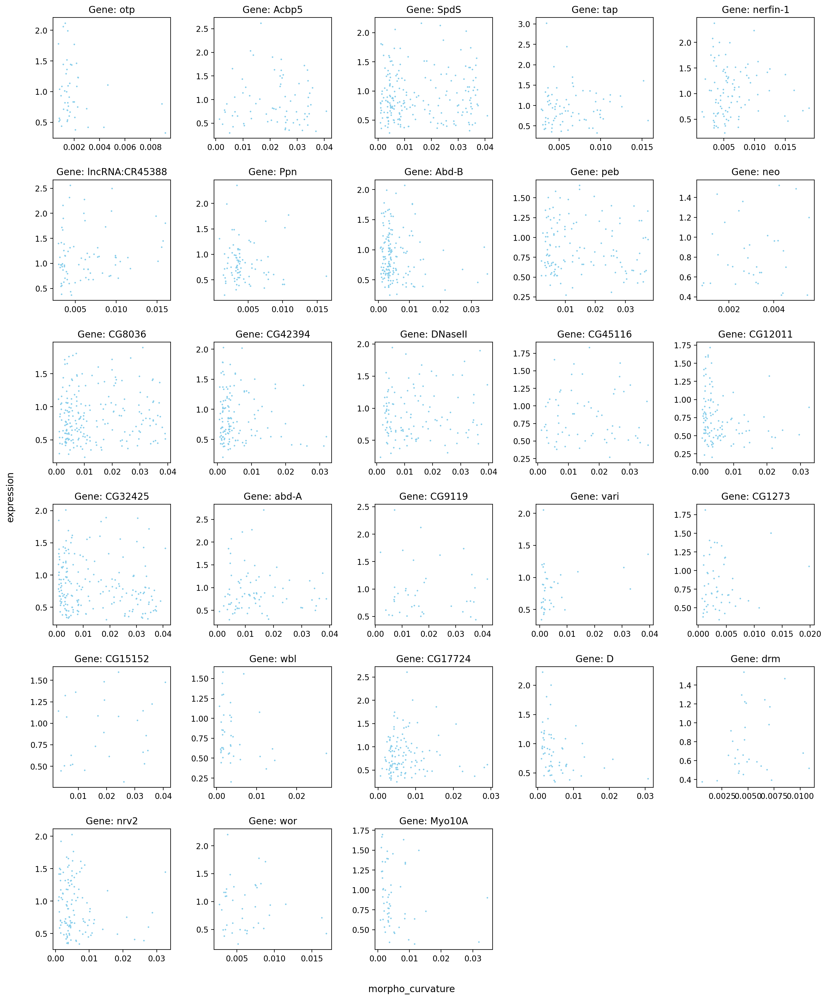

(<Figure size 1500x1800 with 28 Axes>,
 [<AxesSubplot:title={'center':'Gene: otp'}>,
  <AxesSubplot:title={'center':'Gene: Acbp5'}>,
  <AxesSubplot:title={'center':'Gene: SpdS'}>,
  <AxesSubplot:title={'center':'Gene: tap'}>,
  <AxesSubplot:title={'center':'Gene: nerfin-1'}>,
  <AxesSubplot:title={'center':'Gene: lncRNA:CR45388'}>,
  <AxesSubplot:title={'center':'Gene: Ppn'}>,
  <AxesSubplot:title={'center':'Gene: Abd-B'}>,
  <AxesSubplot:title={'center':'Gene: peb'}>,
  <AxesSubplot:title={'center':'Gene: neo'}>,
  <AxesSubplot:title={'center':'Gene: CG8036'}>,
  <AxesSubplot:title={'center':'Gene: CG42394'}>,
  <AxesSubplot:title={'center':'Gene: DNaseII'}>,
  <AxesSubplot:title={'center':'Gene: CG45116'}>,
  <AxesSubplot:title={'center':'Gene: CG12011'}>,
  <AxesSubplot:title={'center':'Gene: CG32425'}>,
  <AxesSubplot:title={'center':'Gene: abd-A'}>,
  <AxesSubplot:title={'center':'Gene: CG9119'}>,
  <AxesSubplot:title={'center':'Gene: vari'}>,
  <AxesSubplot:title={'center':'Gene:

In [49]:
st.pl.glm_fit(
    adata=hc_adata,
    gene=glm_data.index.tolist(),
    ncols=5,
    feature_x="morpho_curvature",
    feature_y="expression",
    glm_key="glm_degs",
    show_point=True,
    show_line=False,
    show_legend=False,
    save_show_or_return="all",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germ_layer_high_acceleration_morpho_curvature_glm_degs_fit"), prefix=None, ext="pdf", dpi=300)
)

In [39]:
for gn in glm_data.index:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "curvature_genes")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=hc_germ_pc.point_data["obs_index"].tolist()
    exp = hc_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    
    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.4] = 0.2
    add_model_labels(model=hc_germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=hc_germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_genes, f"{sample_id}_germ_layer_high_acceleration_morpho_curvature_model_{_gn}.pdf")
    )

In [40]:
for gn in glm_data.index:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "curvature_genes_colorbar")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=hc_germ_pc.point_data["obs_index"].tolist()
    exp = hc_adata[pc_index, gn].X.A.flatten()
    st.tdr.add_model_labels(model=hc_germ_pc, labels=exp, key_added=gn, where="point_data",inplace=True, colormap="afmhot_r")

    st.pl.three_d_plot(
        model=hc_germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=0.4,
        colormap="afmhot_r",
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_genes, f"{sample_id}_germ_layer_high_acceleration_morpho_curvature_model_{_gn}.pdf")
    )

In [50]:
germ_adata.X= germ_adata.layers["X_counts"].copy()
sc.pp.normalize_total(germ_adata)
sc.pp.log1p(germ_adata)

for gn in glm_data.index:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "curvature_genes_germ_layer")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    
    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.4] = 0.2
    add_model_labels(model=germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_genes, f"{sample_id}_germ_layer_morpho_curvature_model_{_gn}.pdf")
    )

In [51]:
for gn in glm_data.index:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    out_image_genes = os.path.join(out_image_path, "curvature_genes_germ_layer_colorbar")
    Path(out_image_genes).mkdir(parents=True, exist_ok=True)
    
    pc_index=germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    st.tdr.add_model_labels(model=germ_pc, labels=exp, key_added=gn, where="point_data",inplace=True, colormap="afmhot_r")

    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=0.4,
        colormap="afmhot_r",
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_genes, f"{sample_id}_germ_layer_morpho_curvature_model_{_gn}.pdf")
    )

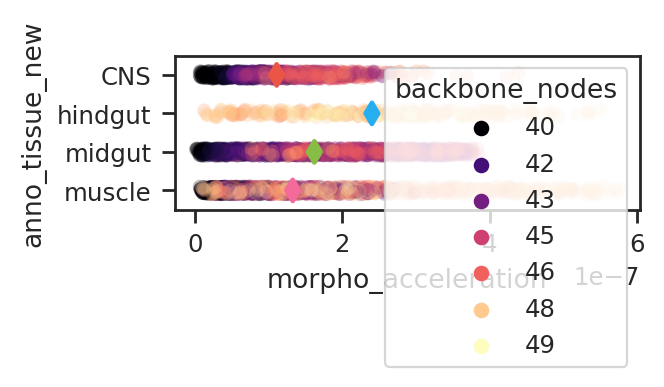

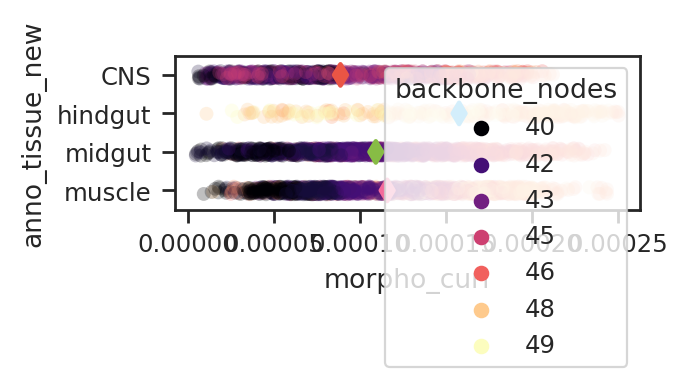

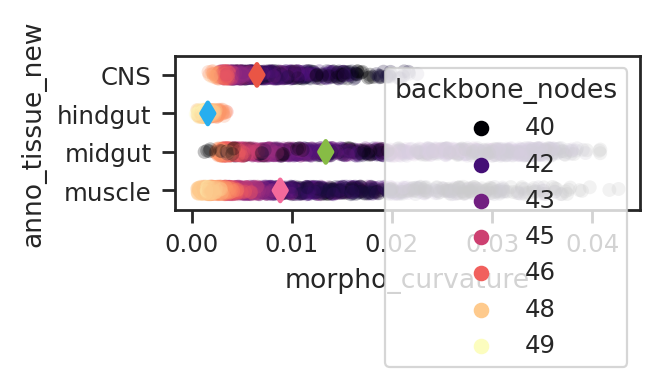

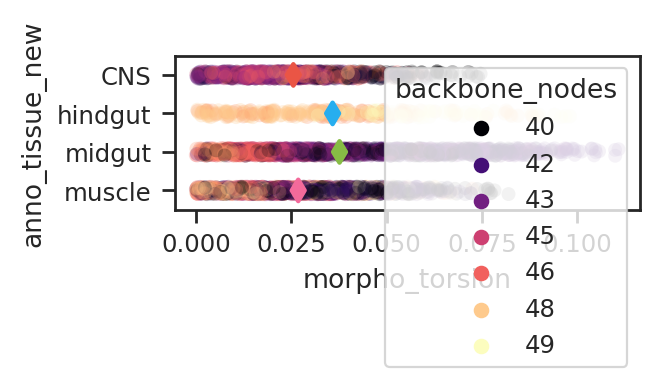

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt

hc_data = hc_adata.obs[
    ["anno_tissue_new", "morpho_acceleration", "morpho_curl", "morpho_curvature", "morpho_torsion", "backbone_nodes"]]

sns.set_theme(context="paper", style="ticks", font="Arial")
for i in ["morpho_acceleration", "morpho_curl", "morpho_curvature", "morpho_torsion"]:
    f, ax = plt.subplots(figsize=(3, 1))
    # Show each observation with a scatterplot
    sns.stripplot(
        data=hc_data, x=i, y="anno_tissue_new", hue="backbone_nodes",
        alpha=.25, zorder=1, palette="magma", legend=True,
    )

    sns.pointplot(
        data=hc_data, x=i, y="anno_tissue_new",
        join=False, dodge=.8 - .8 / 3,
        palette={"CNS": "#ea5545", "hindgut": "#27aeef", "midgut": "#87bc45", "muscle": "#f46a9b"},
        markers="d", scale=1, errorbar=None,
    )
    plt.savefig(os.path.join(out_image_path, f"{sample_id}_germ_layer_high_acceleration_{i}_backbones_tissue.pdf"), dpi=300, format="pdf",
                bbox_inches="tight")
    plt.show()

## Checking genes

In [53]:
completed_data = []
for gn in glm_data.index:
    data = hc_adata.uns["glm_degs"]["correlation"][gn]
    data = data[["morpho_curvature", "expression"]]
    data = data[data["expression"] != 0]
    data["backbone_nodes"] = hc_adata.obs.loc[data.index, "backbone_nodes"]
    data["GNs"] = gn
    
    # data.sort_values(by="morpho_acceleration", ascending=True, axis=0, inplace=True)
    completed_data.append(data)

completed_data = pd.concat(completed_data, axis=0)
completed_data

,morpho_curvature,expression,backbone_nodes,GNs
689-E8-10_b_S08-E8-10_b_S08-E8-10_b_S08-E8-10_b_S08,0.008895,0.804186,43,otp
1276-E8-10_b_S08-E8-10_b_S08-E8-10_b_S08-E8-10_b_S08,0.002016,0.834869,47,otp
754-E8-10_b_S09-E8-10_b_S09-E8-10_b_S09-E8-10_b_S09,0.004641,1.109619,43,otp
817-E8-10_b_S16-E8-10_b_S16-E8-10_b_S16-E8-10_b_S16,0.004326,0.419382,46,otp
853-E8-10_b_S07-E8-10_b_S07-E8-10_b_S07-E8-10_b_S07,0.003099,0.419382,47,otp
...,...,...,...,...
689-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13,0.008498,0.641308,41,Myo10A
1113-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13,0.002043,0.537116,48,Myo10A
1192-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13-E8-10_b_S13,0.001459,1.153337,48,Myo10A
1053-E8-10_b_S15-E8-10_b_S15-E8-10_b_S15-E8-10_b_S15,0.001455,1.238204,48,Myo10A


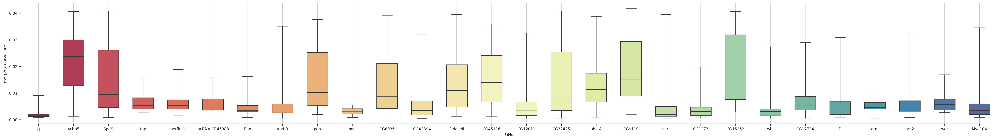

In [54]:
sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(40, 5))

# Plot the orbital period with horizontal boxes
sns.boxplot(x="GNs", y="morpho_curvature", data=completed_data, whis=[0, 100], width=.6, palette="Spectral")

# Tweak the visual presentation
ax.xaxis.grid(True)
sns.despine(trim=True, left=True)
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germ_layer_high_acceleration_morpho_curvature_glm_degs_boxplot.pdf"), dpi=300, format="pdf", bbox_inches="tight")
plt.show()

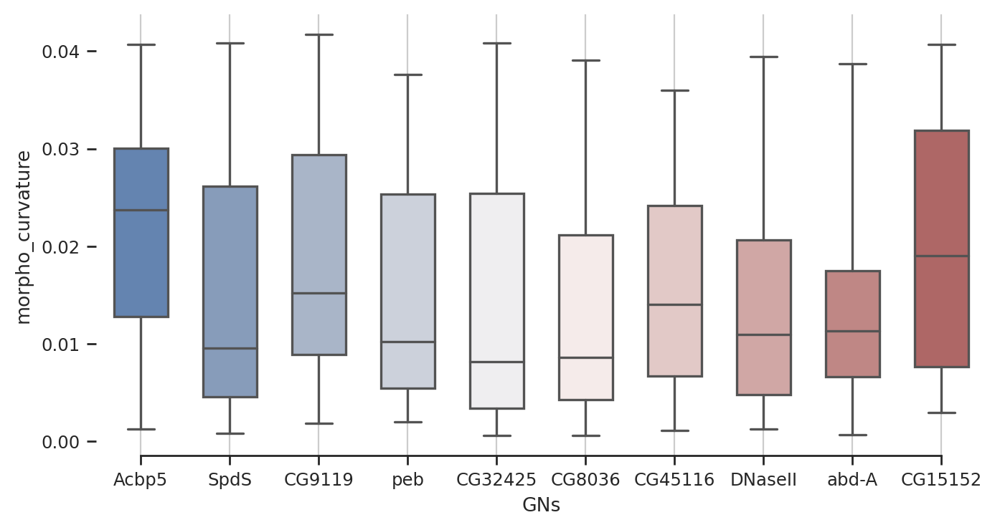

In [56]:
GNs = ["Acbp5", "SpdS", "CG9119", "peb", "CG32425", "CG8036", "CG45116", "DNaseII", "abd-A", "CG15152"]
selected_data = []
for gn in GNs:
    data = hc_adata.uns["glm_degs"]["correlation"][gn]
    data = data[["morpho_curvature", "expression"]]
    data = data[data["expression"] != 0]
    data["backbone_nodes"] = hc_adata.obs.loc[data.index, "backbone_nodes"]
    data["GNs"] = gn
    
    # data.sort_values(by="morpho_acceleration", ascending=True, axis=0, inplace=True)
    selected_data.append(data)

selected_data = pd.concat(selected_data, axis=0)

sns.set_theme(context="paper", style="ticks", font="Arial")
f, ax = plt.subplots(figsize=(8, 4))

# Plot the orbital period with horizontal boxes
sns.boxplot(x="GNs", y="morpho_curvature", data=selected_data, whis=[0, 100], width=.6, palette="vlag")

# Tweak the visual presentation
ax.xaxis.grid(True)
sns.despine(trim=True, left=True)
plt.savefig(os.path.join(out_image_path, f"{sample_id}_germ_layer_high_acceleration_morpho_curvature_glm_degs_selected_boxplot.pdf"), dpi=300, format="pdf", bbox_inches="tight")
plt.show()

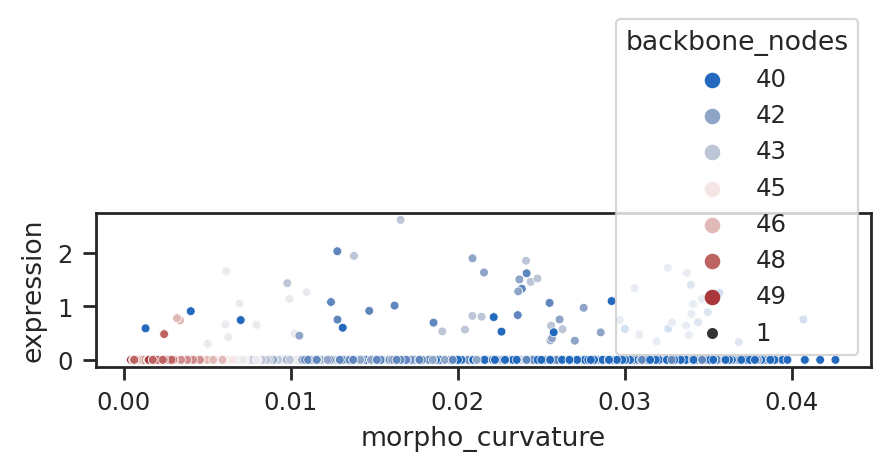

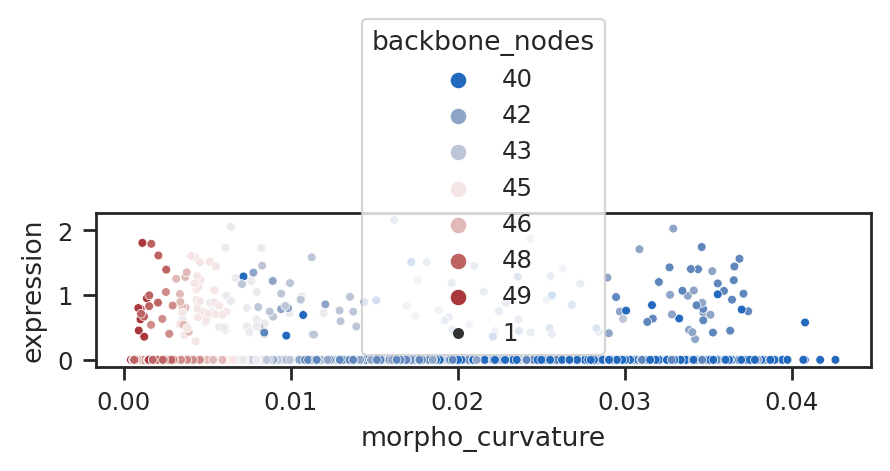

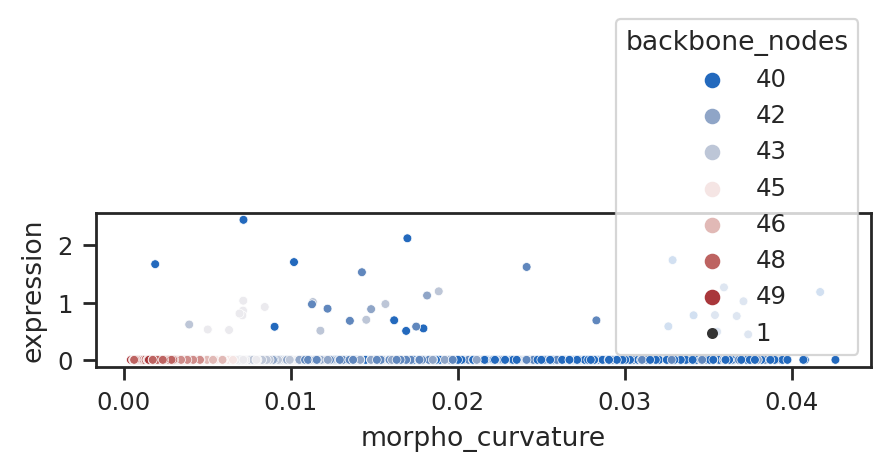

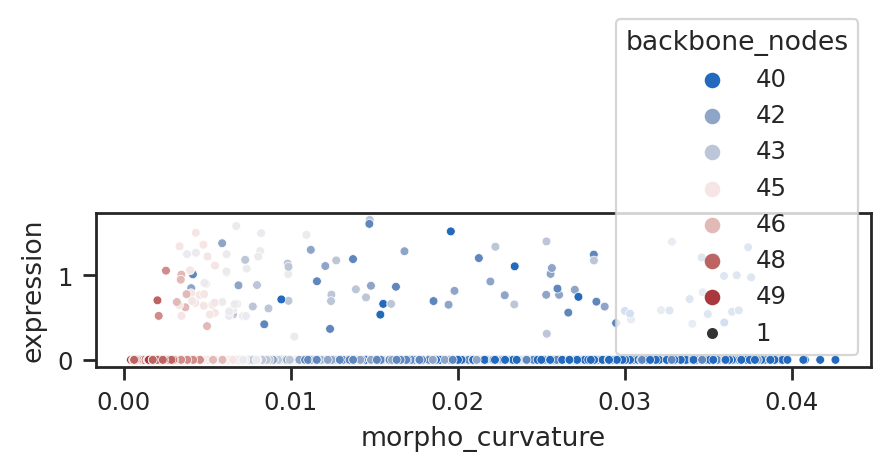

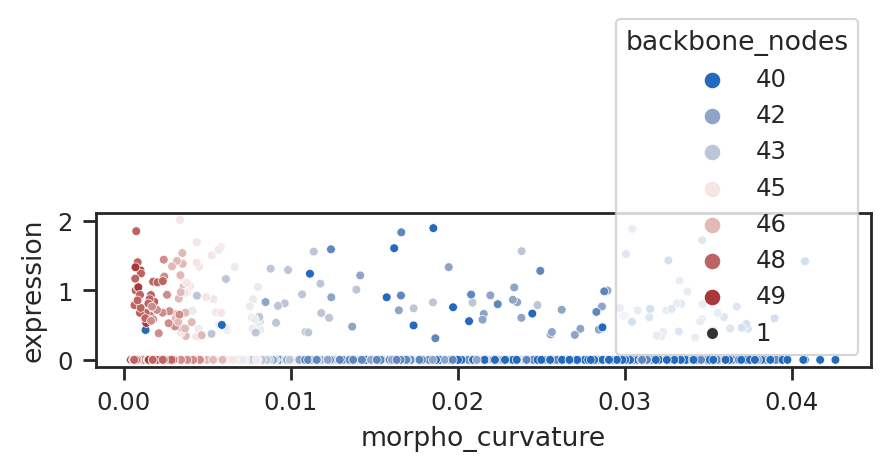

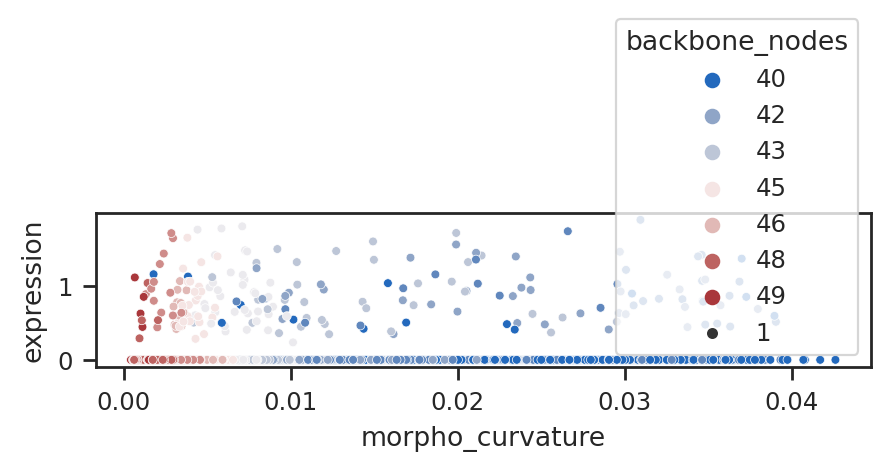

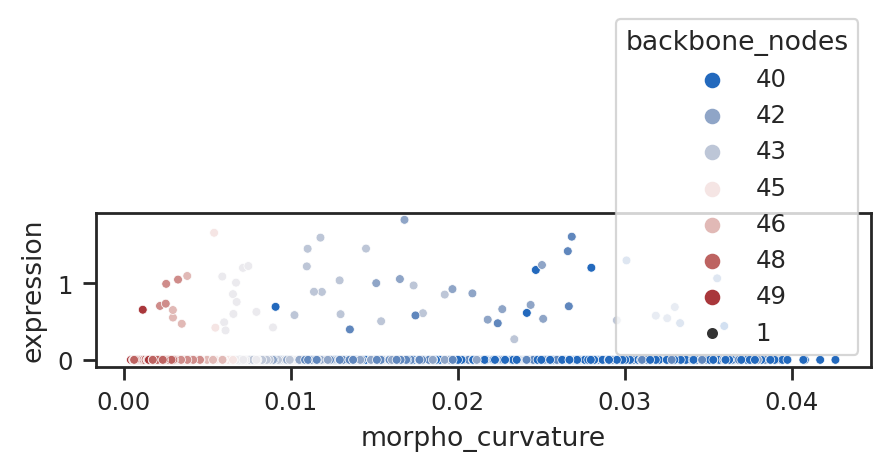

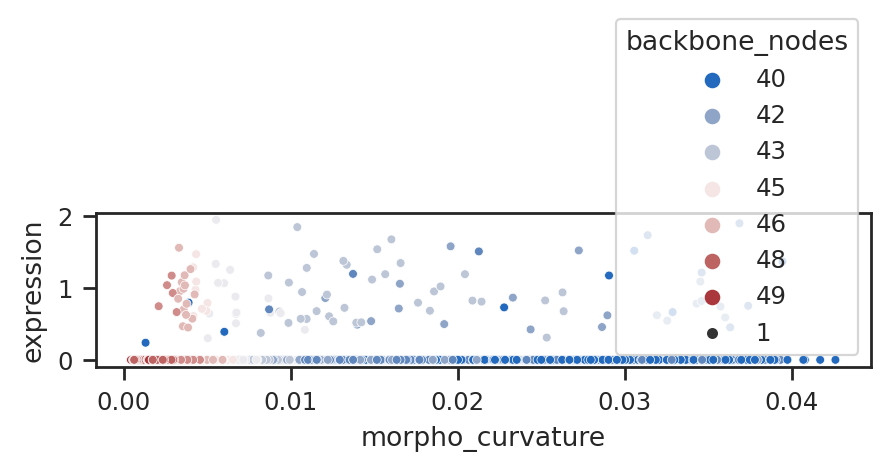

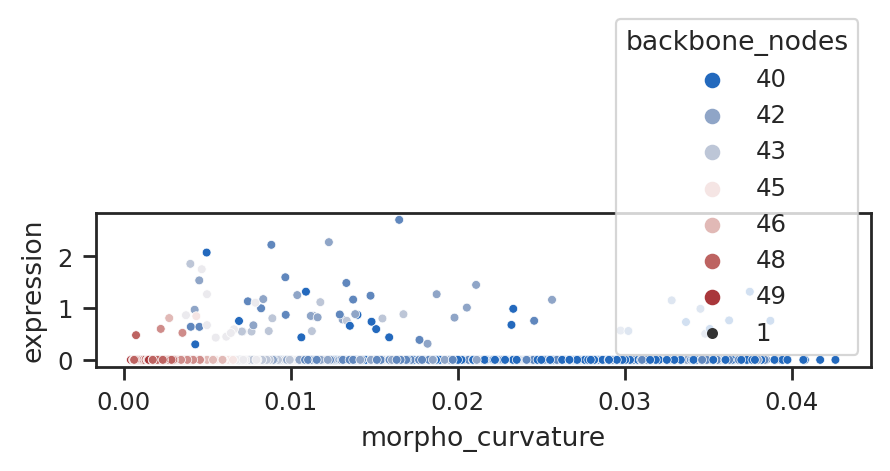

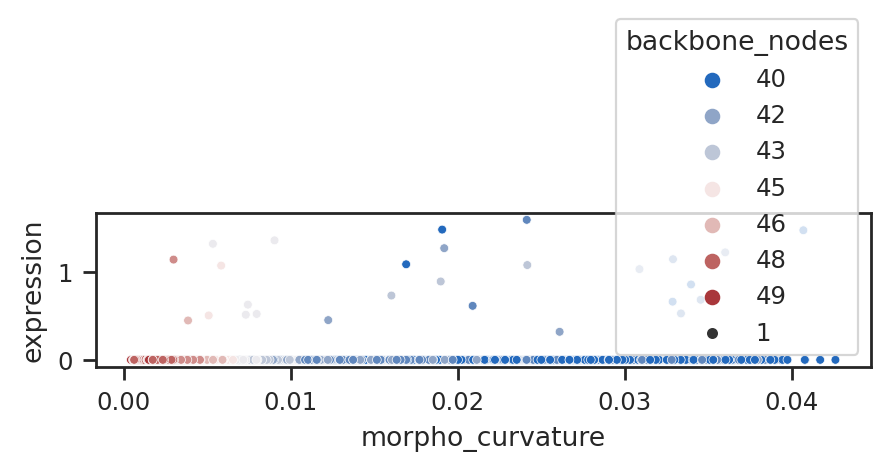

In [57]:
for gn in GNs:
    data = hc_adata.uns["glm_degs"]["correlation"][gn]
    data = data[["morpho_curvature", "expression"]]
    data["backbone_nodes"] = hc_adata.obs.loc[data.index, "backbone_nodes"]
    # data.sort_values(by="morpho_acceleration", ascending=True, axis=0, inplace=True)

    sns.set_theme(context="paper", style="ticks", font="Arial")
    f, ax = plt.subplots(figsize=(5, 1))
    sns.scatterplot(
        data=data, x="morpho_curvature", y="expression", hue="backbone_nodes", # selected_data[selected_data["GNs"] == "Acbp5"]
        size=1, sizes=(10, 50), ax=ax, legend=True, palette="vlag"
    )
    plt.savefig(os.path.join(out_image_path, f"{sample_id}_germ_layer_scatter_{gn}.pdf"), dpi=300, format="pdf", bbox_inches="tight")
    plt.show()

In [58]:
for gn in ["peb"]:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn
    
    pc_index=germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0
    
    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.4] = 0.2
    add_model_labels(model=germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data",inplace=True, colormap="afmhot_r")
    
    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter=False,
        off_screen=False,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
    )